In [1]:
run_gridsearch = False
skip_best_model_train = True
hyperparam_csv_file = "warm_springs_hourly_hyperparams.csv"

In [2]:
import sys
import os
import itertools
import pandas as pd
current_dir = os.getcwd()
print(current_dir)

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all


In [3]:
library_path = os.path.join('..', '..', '..','..','UCB-USACE-LSTMs')
sys.path.insert(0, library_path)
print(sys.path)

['..\\..\\..\\..\\UCB-USACE-LSTMs', 'F:\\Dino\\UCB-USACE-LSTMs\\UCB_training\\models\\warm_springs_all', 'C:\\Users\\Dino\\anaconda3\\python312.zip', 'C:\\Users\\Dino\\anaconda3\\DLLs', 'C:\\Users\\Dino\\anaconda3\\Lib', 'C:\\Users\\Dino\\anaconda3', '', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32\\lib', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\Pythonwin']


In [4]:
from pathlib import Path
from neuralhydrology.evaluation.metrics import *
from UCB_training.UCB_train import UCB_trainer
from UCB_training.UCB_utils import combinedPlot
from UCB_training.UCB_utils import fancyCombinedPlot
from UCB_training.UCB_utils import combinedPlotFromDf
from UCB_training.UCB_utils import fancyCombinedPlotFromDf

In [5]:
current_path = os.getcwd()
library_path = current_path.split('UCB-USACE-LSTMs')[0] + 'UCB-USACE-LSTMs'

target_path = os.path.join(library_path, 'UCB_training', 'models', 'warm_springs_all')

if os.path.exists(target_path):
    os.chdir(target_path)
    print("Current Working Directory:", os.getcwd())
    print("Train Basin File Exists:", os.path.exists("warm_springs")) 
else:
    print(f"Error: The target path '{target_path}' does not exist.")

Current Working Directory: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all
Train Basin File Exists: False


In [6]:
path_to_csv = Path(library_path +'/russian_river_data')
path_to_yaml = Path("warm_springs_dam_nlayer.yaml")
path_to_physics_data = Path(library_path + "/russian_river_data/WarmSprings_Inflow_hourly.csv")

In [7]:
path_to_physics_data

WindowsPath('F:/Dino/UCB-USACE-LSTMs/russian_river_data/WarmSprings_Inflow_hourly.csv')

In [8]:
features_with_physics = [
    #from daily.csv
    "DRY CREEK 20 PRECIP-INC SCREENED",
    "DRY CREEK 20 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "DRY CREEK 30 PRECIP-INC SCREENED",
    "DRY CREEK 30 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "SANTA ROSA CA HUMIDITY USAF-NOAA",
    "SANTA ROSA CA SOLAR RADIATION USAF-NOAA",
    "SANTA ROSA CA TEMPERATURE USAF-NOAA",
    "SANTA ROSA CA WINDSPEED USAF-NOAA",
    #from Warm_Spring_Inflow.csv
    'Dry Creek 20 ET-POTENTIAL',
    'Dry Creek 20 FLOW',
    'Dry Creek 20 FLOW-BASE',
    'Dry Creek 20 INFILTRATION',
    'Dry Creek 20 PERC-SOIL',
    'Dry Creek 20 SATURATION FRACTION',
    'Dry Creek 30 ET-POTENTIAL',
    'Dry Creek 30 FLOW',
    'Dry Creek 30 FLOW-BASE',
    'Dry Creek 30 INFILTRATION',
    'Dry Creek 30 PERC-SOIL',
    'Dry Creek 30 SATURATION FRACTION',
    'Warm Springs Dam Inflow FLOW',
]

In [9]:
hyperparam_space = {
    "hidden_size": [64, 128, 256],
    "seq_length": [90, 168, 336],
    "num_layers": [1],
    "epochs": [16, 32]
}
fixed_dropout = 0.4
no_physics_results = []
physics_results = []

NoPhysics: {'hidden_size': 64, 'seq_length': 90, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 08:35:26,324: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083526\output.log initialized.
2025-03-09 08:35:26,325: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083526
2025-03-09 08:35:26,326: ### Run configurations for testing_run
2025-03-09 08:35:26,327: experiment_name: testing_run
2025-03-09 08:35:26,328: train_basin_file: warm springs
2025-03-09 08:35:26,329: validation_basin_file: warm springs
2025-03-09 08:35:26,331: test_basin_file: warm springs
2025-03-09 08:35:26,331: train_start_date: 1994-10-01 00:00:00
2025-03-09 08:35:26,333: train_end_date: 2002-09-30 00:00:00
2025-03-09 08:35:26,334: validation_start_date: 2002-10-01 00:00:00
2025-03-09 08:35:26,335: validation_end_date: 2005-09-30 00:00:00
2025-03-09 08:35:26,336: test_start_date: 2005-10-01

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.68s/it]
2025-03-09 08:38:16,102: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083526\validation\model_epoch016\validation_metrics.csv
2025-03-09 08:38:16,110: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083526\validation\model_epoch016\validation_results.p
got predictions


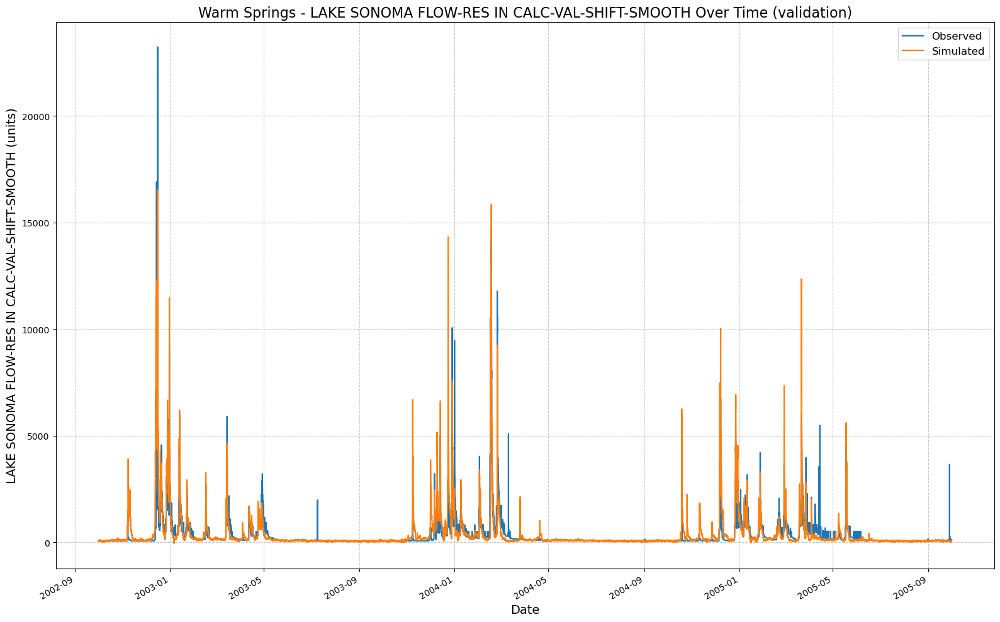

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083526\results_output_validation.csv
NoPhysics: {'hidden_size': 64, 'seq_length': 90, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 08:38:17,085: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083817\output.log initialized.
2025-03-09 08:38:17,087: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083817
2025-03-09 08:38:17,091: ### Run configurations for testing_run
2025-03-09 08:38:17,094: experiment_name: testing_run
2025-03-09 08:38:17,096: train_basin_file: warm springs
2025-03-09 08:38:17,101: validation_basin_file: warm springs
2025-03-09 08:38:17,103: test_basin_file: warm springs
2025-03-09 08:38:17,106: train_start_date: 1994-10-01 00:00:00
2025-03-09 08:38:17,109: train_end_date: 2002-09-30 00:00:00
2025-03-09 08:38:17,111: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.62s/it]
2025-03-09 08:43:16,155: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083817\validation\model_epoch032\validation_metrics.csv
2025-03-09 08:43:16,161: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083817\validation\model_epoch032\validation_results.p
got predictions


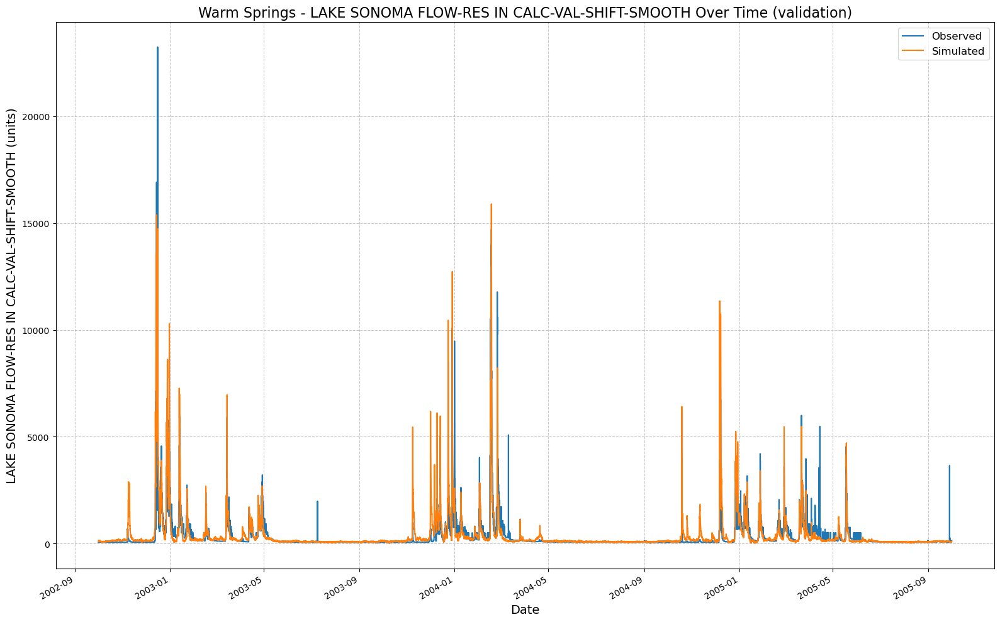

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_083817\results_output_validation.csv
NoPhysics: {'hidden_size': 64, 'seq_length': 168, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 08:43:17,105: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084317\output.log initialized.
2025-03-09 08:43:17,107: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084317
2025-03-09 08:43:17,109: ### Run configurations for testing_run
2025-03-09 08:43:17,111: experiment_name: testing_run
2025-03-09 08:43:17,113: train_basin_file: warm springs
2025-03-09 08:43:17,115: validation_basin_file: warm springs
2025-03-09 08:43:17,118: test_basin_file: warm springs
2025-03-09 08:43:17,122: train_start_date: 1994-10-01 00:00:00
2025-03-09 08:43:17,125: train_end_date: 2002-09-30 00:00:00
2025-03-09 08:43:17,126: validation_s

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.89s/it]
2025-03-09 08:46:30,407: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084317\validation\model_epoch016\validation_metrics.csv
2025-03-09 08:46:30,419: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084317\validation\model_epoch016\validation_results.p
got predictions


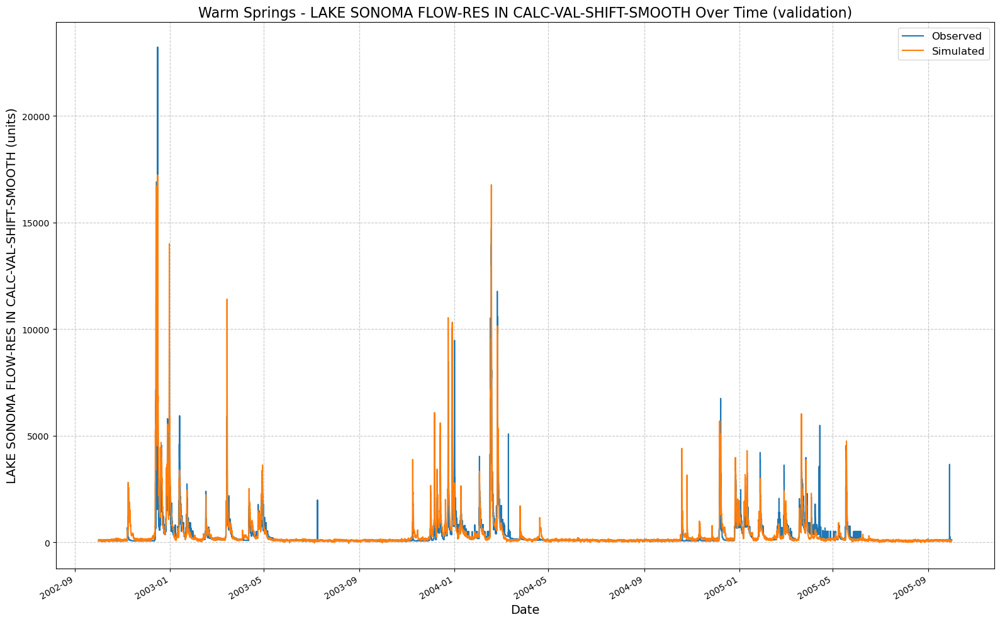

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084317\results_output_validation.csv
NoPhysics: {'hidden_size': 64, 'seq_length': 168, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 08:46:31,406: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084631\output.log initialized.
2025-03-09 08:46:31,408: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084631
2025-03-09 08:46:31,410: ### Run configurations for testing_run
2025-03-09 08:46:31,412: experiment_name: testing_run
2025-03-09 08:46:31,414: train_basin_file: warm springs
2025-03-09 08:46:31,417: validation_basin_file: warm springs
2025-03-09 08:46:31,420: test_basin_file: warm springs
2025-03-09 08:46:31,423: train_start_date: 1994-10-01 00:00:00
2025-03-09 08:46:31,427: train_end_date: 2002-09-30 00:00:00
2025-03-09 08:46:31,431: validation_s

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.13s/it]
2025-03-09 08:52:43,853: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084631\validation\model_epoch032\validation_metrics.csv
2025-03-09 08:52:43,870: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084631\validation\model_epoch032\validation_results.p
got predictions


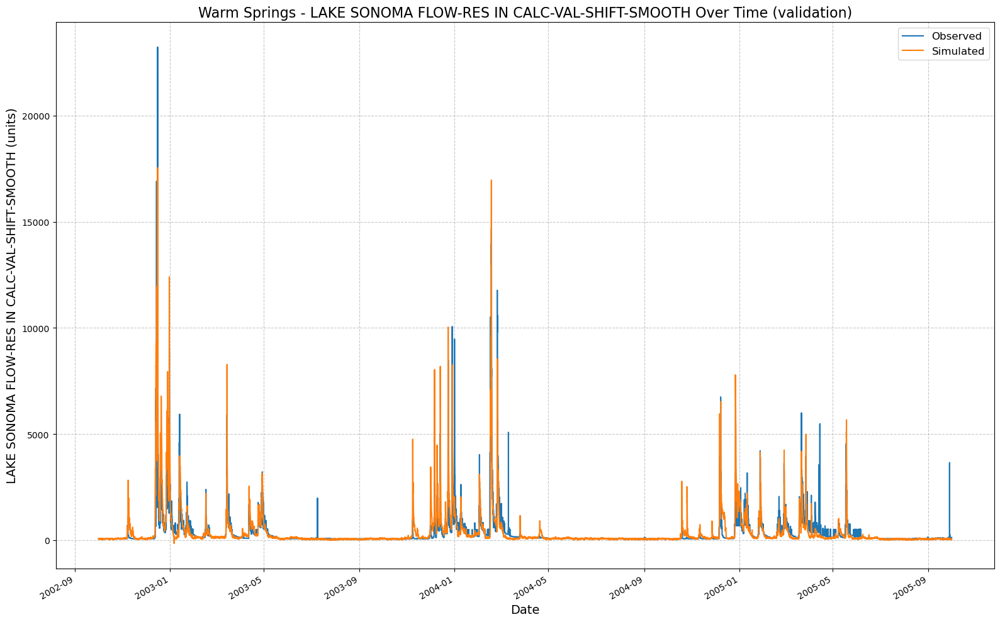

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_084631\results_output_validation.csv
NoPhysics: {'hidden_size': 64, 'seq_length': 336, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 08:52:45,070: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085245\output.log initialized.
2025-03-09 08:52:45,072: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085245
2025-03-09 08:52:45,075: ### Run configurations for testing_run
2025-03-09 08:52:45,078: experiment_name: testing_run
2025-03-09 08:52:45,080: train_basin_file: warm springs
2025-03-09 08:52:45,082: validation_basin_file: warm springs
2025-03-09 08:52:45,085: test_basin_file: warm springs
2025-03-09 08:52:45,086: train_start_date: 1994-10-01 00:00:00
2025-03-09 08:52:45,087: train_end_date: 2002-09-30 00:00:00
2025-03-09 08:52:45,089: validation_s

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.71s/it]
2025-03-09 08:57:25,377: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085245\validation\model_epoch016\validation_metrics.csv
2025-03-09 08:57:25,389: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085245\validation\model_epoch016\validation_results.p
got predictions


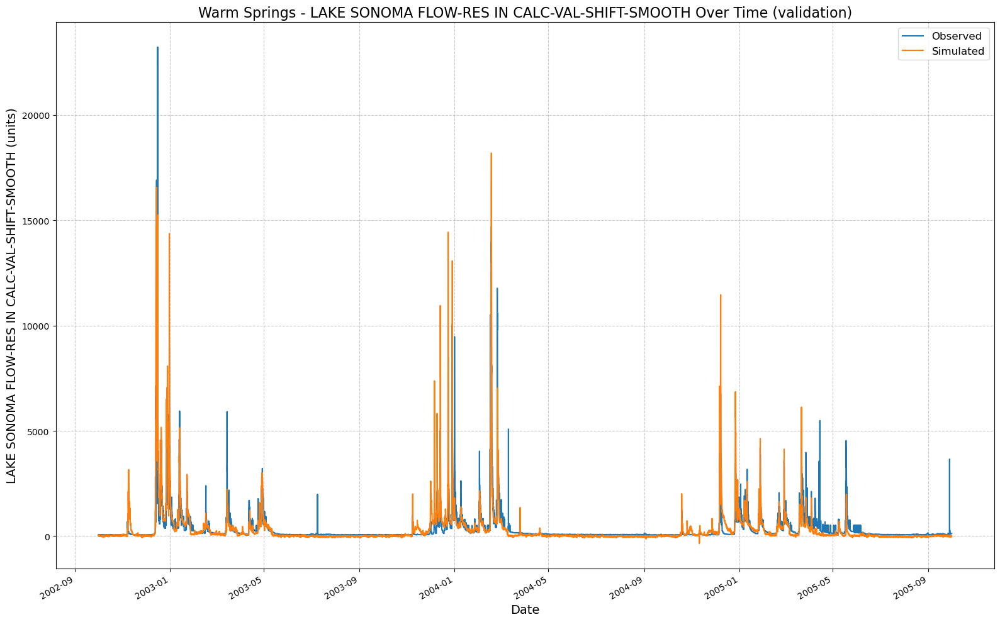

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085245\results_output_validation.csv
NoPhysics: {'hidden_size': 64, 'seq_length': 336, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 08:57:26,350: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085726\output.log initialized.
2025-03-09 08:57:26,353: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085726
2025-03-09 08:57:26,356: ### Run configurations for testing_run
2025-03-09 08:57:26,358: experiment_name: testing_run
2025-03-09 08:57:26,360: train_basin_file: warm springs
2025-03-09 08:57:26,362: validation_basin_file: warm springs
2025-03-09 08:57:26,364: test_basin_file: warm springs
2025-03-09 08:57:26,366: train_start_date: 1994-10-01 00:00:00
2025-03-09 08:57:26,369: train_end_date: 2002-09-30 00:00:00
2025-03-09 08:57:26,371: validation_s

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.11s/it]
2025-03-09 09:06:29,707: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085726\validation\model_epoch032\validation_metrics.csv
2025-03-09 09:06:29,721: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085726\validation\model_epoch032\validation_results.p
got predictions


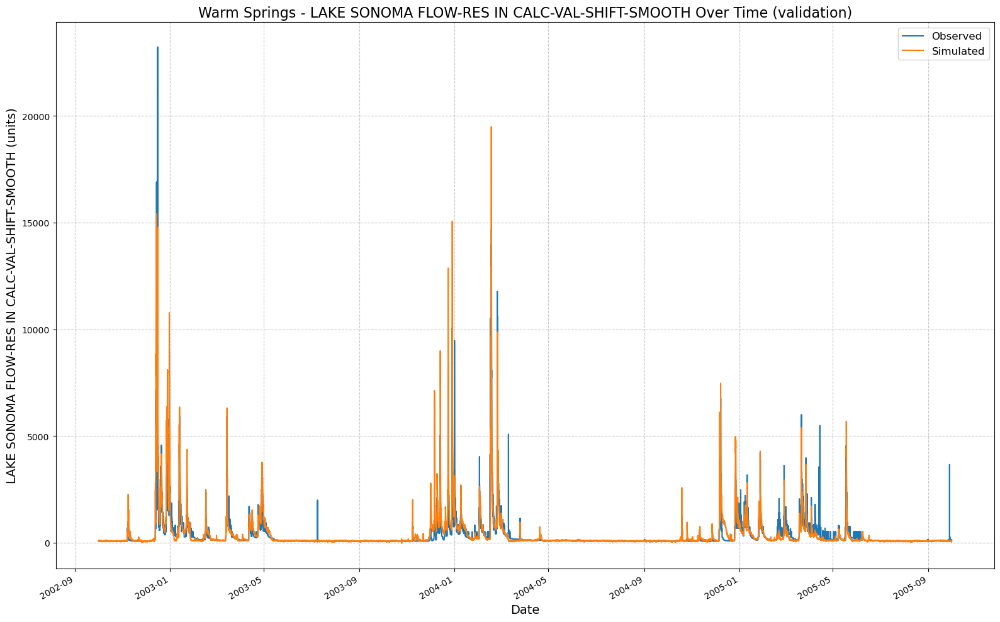

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_085726\results_output_validation.csv
NoPhysics: {'hidden_size': 128, 'seq_length': 90, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 09:06:30,677: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_090630\output.log initialized.
2025-03-09 09:06:30,680: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_090630
2025-03-09 09:06:30,683: ### Run configurations for testing_run
2025-03-09 09:06:30,685: experiment_name: testing_run
2025-03-09 09:06:30,688: train_basin_file: warm springs
2025-03-09 09:06:30,690: validation_basin_file: warm springs
2025-03-09 09:06:30,695: test_basin_file: warm springs
2025-03-09 09:06:30,696: train_start_date: 1994-10-01 00:00:00
2025-03-09 09:06:30,697: train_end_date: 2002-09-30 00:00:00
2025-03-09 09:06:30,698: validation_s

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.82s/it]
2025-03-09 09:11:38,685: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_090630\validation\model_epoch016\validation_metrics.csv
2025-03-09 09:11:38,695: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_090630\validation\model_epoch016\validation_results.p
got predictions


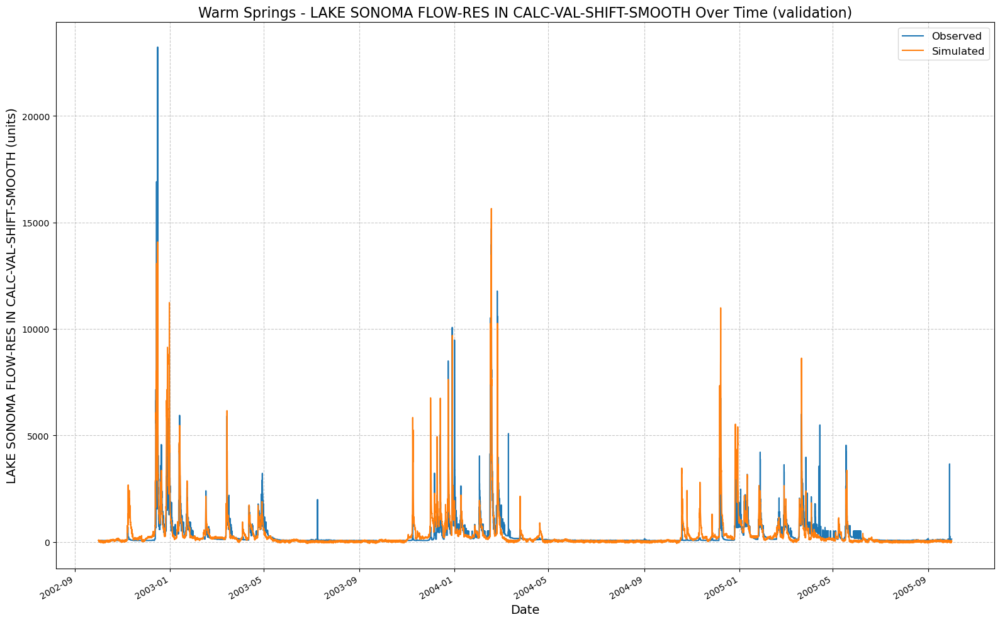

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_090630\results_output_validation.csv
NoPhysics: {'hidden_size': 128, 'seq_length': 90, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 09:11:39,797: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_091139\output.log initialized.
2025-03-09 09:11:39,800: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_091139
2025-03-09 09:11:39,802: ### Run configurations for testing_run
2025-03-09 09:11:39,806: experiment_name: testing_run
2025-03-09 09:11:39,809: train_basin_file: warm springs
2025-03-09 09:11:39,811: validation_basin_file: warm springs
2025-03-09 09:11:39,815: test_basin_file: warm springs
2025-03-09 09:11:39,818: train_start_date: 1994-10-01 00:00:00
2025-03-09 09:11:39,822: train_end_date: 2002-09-30 00:00:00
2025-03-09 09:11:39,825: validation_s

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.24s/it]
2025-03-09 09:21:40,685: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_091139\validation\model_epoch032\validation_metrics.csv
2025-03-09 09:21:40,695: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_091139\validation\model_epoch032\validation_results.p
got predictions


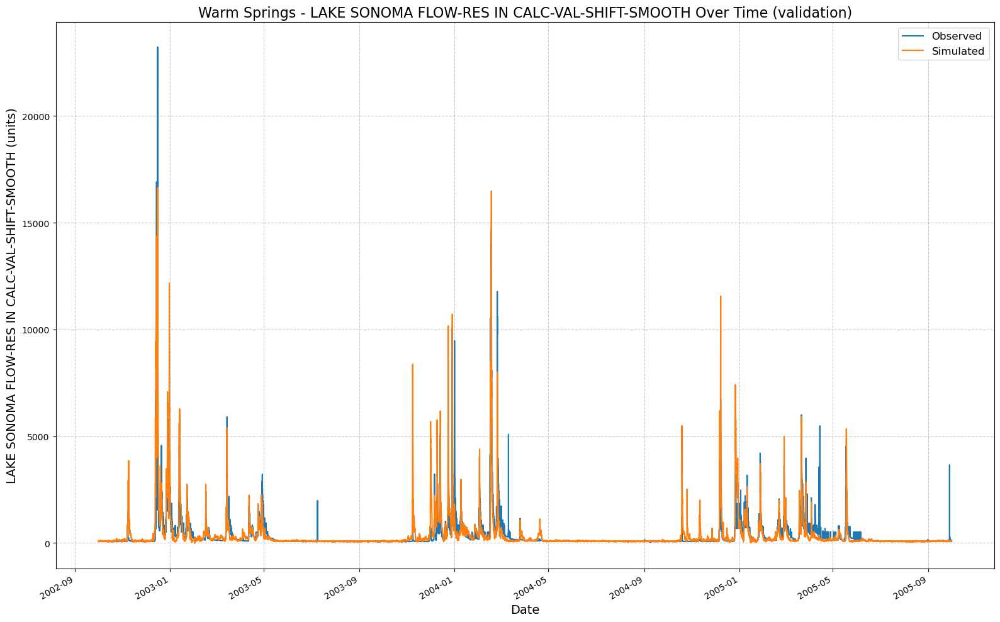

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_091139\results_output_validation.csv
NoPhysics: {'hidden_size': 128, 'seq_length': 168, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 09:21:41,730: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092141\output.log initialized.
2025-03-09 09:21:41,732: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092141
2025-03-09 09:21:41,734: ### Run configurations for testing_run
2025-03-09 09:21:41,736: experiment_name: testing_run
2025-03-09 09:21:41,738: train_basin_file: warm springs
2025-03-09 09:21:41,740: validation_basin_file: warm springs
2025-03-09 09:21:41,741: test_basin_file: warm springs
2025-03-09 09:21:41,742: train_start_date: 1994-10-01 00:00:00
2025-03-09 09:21:41,743: train_end_date: 2002-09-30 00:00:00
2025-03-09 09:21:41,744: validation_

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.03s/it]
2025-03-09 09:29:35,830: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092141\validation\model_epoch016\validation_metrics.csv
2025-03-09 09:29:35,846: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092141\validation\model_epoch016\validation_results.p
got predictions


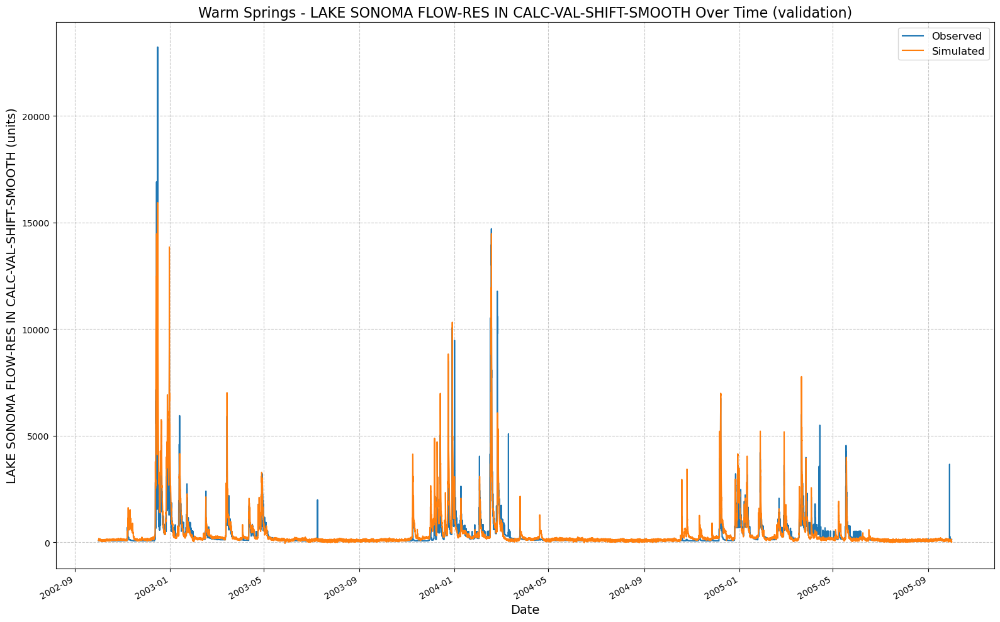

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092141\results_output_validation.csv
NoPhysics: {'hidden_size': 128, 'seq_length': 168, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 09:29:36,826: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092936\output.log initialized.
2025-03-09 09:29:36,828: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092936
2025-03-09 09:29:36,830: ### Run configurations for testing_run
2025-03-09 09:29:36,833: experiment_name: testing_run
2025-03-09 09:29:36,834: train_basin_file: warm springs
2025-03-09 09:29:36,836: validation_basin_file: warm springs
2025-03-09 09:29:36,838: test_basin_file: warm springs
2025-03-09 09:29:36,839: train_start_date: 1994-10-01 00:00:00
2025-03-09 09:29:36,841: train_end_date: 2002-09-30 00:00:00
2025-03-09 09:29:36,843: validation_

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.94s/it]
2025-03-09 09:45:04,871: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092936\validation\model_epoch032\validation_metrics.csv
2025-03-09 09:45:04,880: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092936\validation\model_epoch032\validation_results.p
got predictions


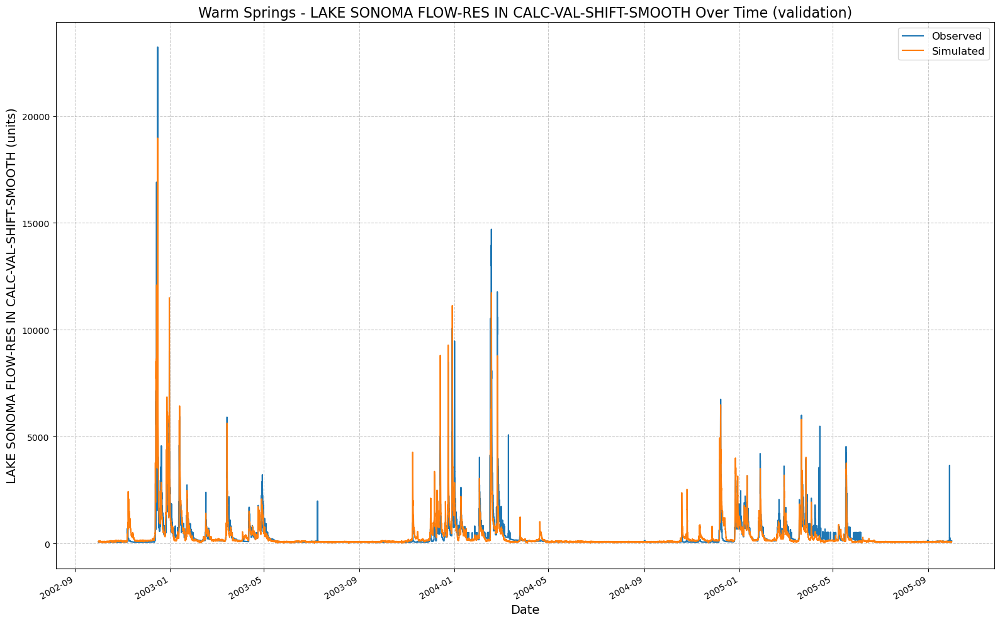

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_092936\results_output_validation.csv
NoPhysics: {'hidden_size': 128, 'seq_length': 336, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 09:45:05,904: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_094505\output.log initialized.
2025-03-09 09:45:05,907: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_094505
2025-03-09 09:45:05,910: ### Run configurations for testing_run
2025-03-09 09:45:05,912: experiment_name: testing_run
2025-03-09 09:45:05,914: train_basin_file: warm springs
2025-03-09 09:45:05,917: validation_basin_file: warm springs
2025-03-09 09:45:05,921: test_basin_file: warm springs
2025-03-09 09:45:05,924: train_start_date: 1994-10-01 00:00:00
2025-03-09 09:45:05,926: train_end_date: 2002-09-30 00:00:00
2025-03-09 09:45:05,928: validation_

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:11<00:00, 11.56s/it]
2025-03-09 09:59:01,680: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_094505\validation\model_epoch016\validation_metrics.csv
2025-03-09 09:59:01,691: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_094505\validation\model_epoch016\validation_results.p
got predictions


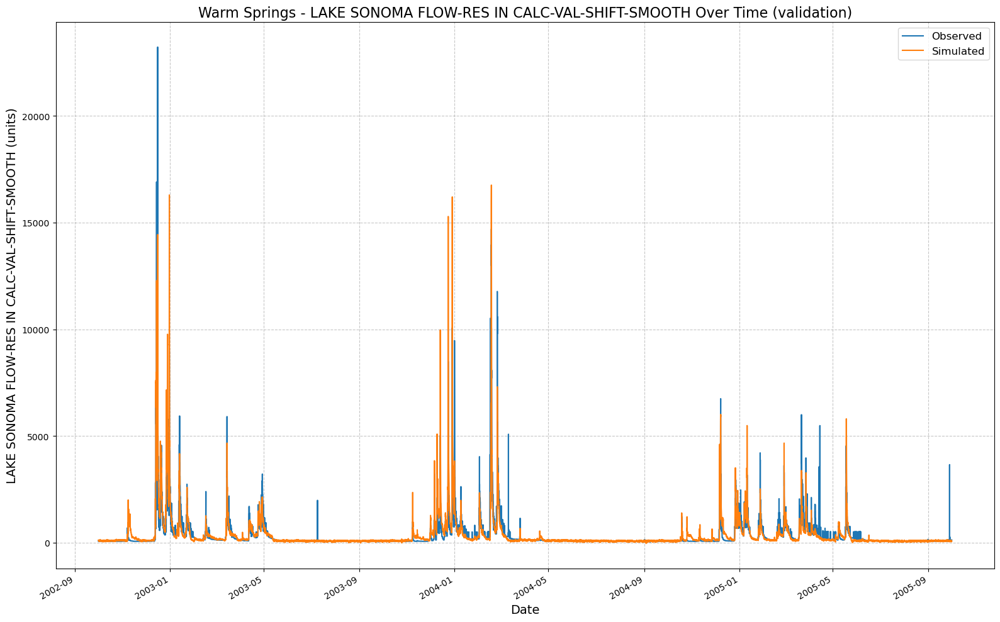

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_094505\results_output_validation.csv
NoPhysics: {'hidden_size': 128, 'seq_length': 336, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 09:59:02,905: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_095902\output.log initialized.
2025-03-09 09:59:02,906: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_095902
2025-03-09 09:59:02,910: ### Run configurations for testing_run
2025-03-09 09:59:02,912: experiment_name: testing_run
2025-03-09 09:59:02,913: train_basin_file: warm springs
2025-03-09 09:59:02,914: validation_basin_file: warm springs
2025-03-09 09:59:02,915: test_basin_file: warm springs
2025-03-09 09:59:02,916: train_start_date: 1994-10-01 00:00:00
2025-03-09 09:59:02,917: train_end_date: 2002-09-30 00:00:00
2025-03-09 09:59:02,918: validation_

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:11<00:00, 11.99s/it]
2025-03-09 10:26:30,018: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_095902\validation\model_epoch032\validation_metrics.csv
2025-03-09 10:26:30,025: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_095902\validation\model_epoch032\validation_results.p
got predictions


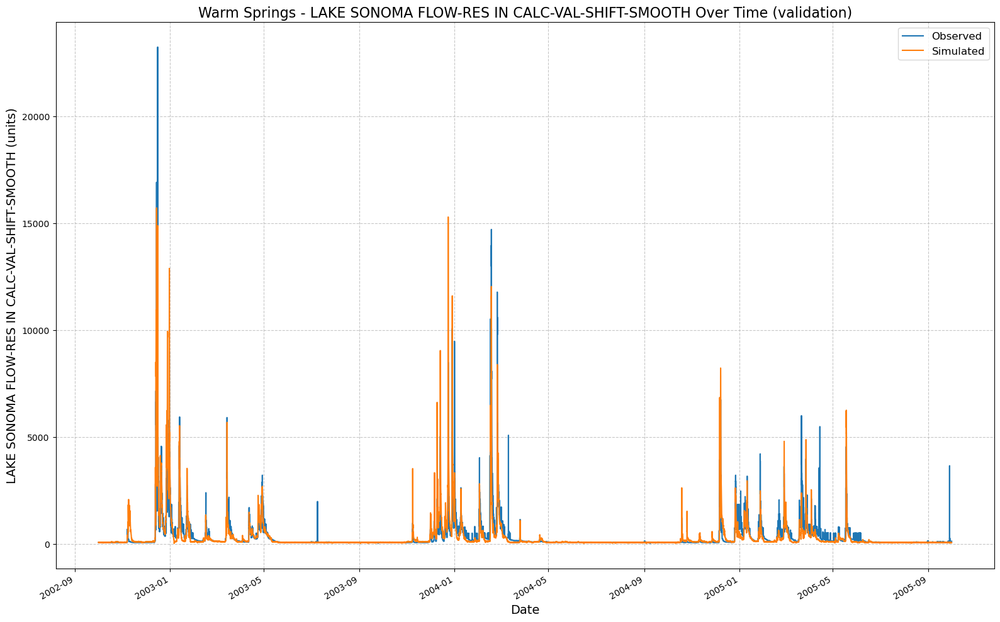

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_095902\results_output_validation.csv
NoPhysics: {'hidden_size': 256, 'seq_length': 90, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 10:26:31,085: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_102631\output.log initialized.
2025-03-09 10:26:31,087: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_102631
2025-03-09 10:26:31,089: ### Run configurations for testing_run
2025-03-09 10:26:31,091: experiment_name: testing_run
2025-03-09 10:26:31,092: train_basin_file: warm springs
2025-03-09 10:26:31,093: validation_basin_file: warm springs
2025-03-09 10:26:31,095: test_basin_file: warm springs
2025-03-09 10:26:31,096: train_start_date: 1994-10-01 00:00:00
2025-03-09 10:26:31,099: train_end_date: 2002-09-30 00:00:00
2025-03-09 10:26:31,101: validation_s

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.44s/it]
2025-03-09 10:32:21,301: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_102631\validation\model_epoch016\validation_metrics.csv
2025-03-09 10:32:21,315: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_102631\validation\model_epoch016\validation_results.p
got predictions


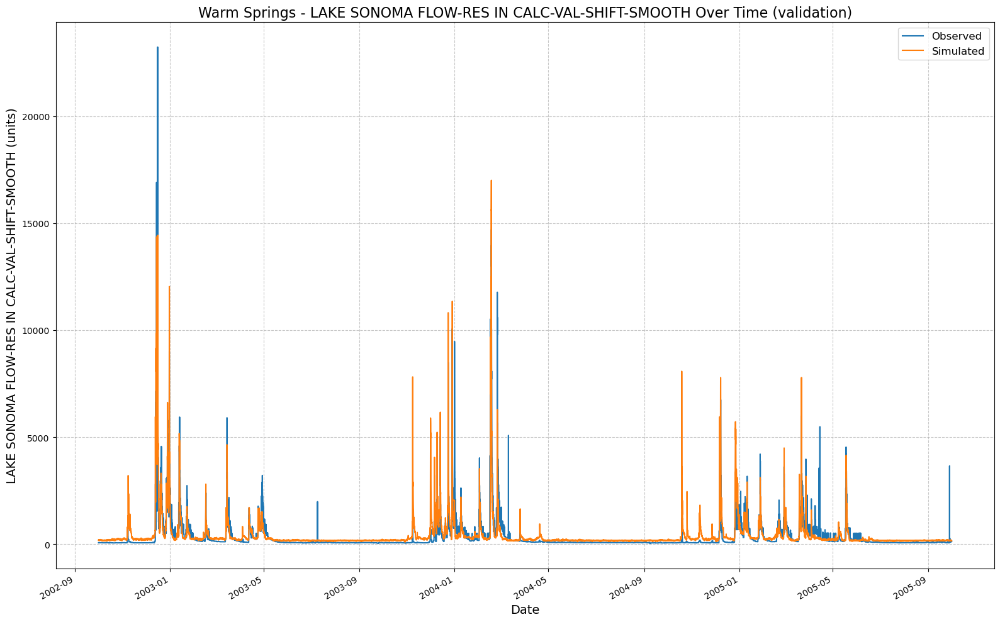

[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_102631\results_output_validation.csv
NoPhysics: {'hidden_size': 256, 'seq_length': 90, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 10:32:22,280: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_103222\output.log initialized.
2025-03-09 10:32:22,283: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_103222
2025-03-09 10:32:22,286: ### Run configurations for testing_run
2025-03-09 10:32:22,289: experiment_name: testing_run
2025-03-09 10:32:22,290: train_basin_file: warm springs
2025-03-09 10:32:22,293: validation_basin_file: warm springs
2025-03-09 10:32:22,295: test_basin_file: warm springs
2025-03-09 10:32:22,297: train_start_date: 1994-10-01 00:00:00
2025-03-09 10:32:22,298: train_end_date: 2002-09-30 00:00:00


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


2025-03-09 10:32:22,300: validation_start_date: 2002-10-01 00:00:00
2025-03-09 10:32:22,301: validation_end_date: 2005-09-30 00:00:00
2025-03-09 10:32:22,305: test_start_date: 2005-10-01 00:00:00
2025-03-09 10:32:22,306: test_end_date: 2009-09-29 00:00:00
2025-03-09 10:32:22,310: device: cuda:0
2025-03-09 10:32:22,311: physics_informed: False
2025-03-09 10:32:22,313: physics_data_file: None
2025-03-09 10:32:22,316: validate_every: 5
2025-03-09 10:32:22,317: validate_n_random_basins: 1
2025-03-09 10:32:22,319: metrics: ['NSE', 'MSE']
2025-03-09 10:32:22,320: model: cudalstm
2025-03-09 10:32:22,322: head: regression
2025-03-09 10:32:22,323: output_activation: linear
2025-03-09 10:32:22,325: hidden_size: 256
2025-03-09 10:32:22,326: initial_forget_bias: 3
2025-03-09 10:32:22,328: output_dropout: 0.4
2025-03-09 10:32:22,329: num_layers: 1
2025-03-09 10:32:22,331: dev_mode: True
2025-03-09 10:32:22,333: optimizer: Adam
2025-03-09 10:32:22,335: loss: NSE
2025-03-09 10:32:22,336: learning_rat

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.06s/it]
2025-03-09 10:43:49,355: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_103222\validation\model_epoch032\validation_metrics.csv
2025-03-09 10:43:49,370: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_103222\validation\model_epoch032\validation_results.p
got predictions


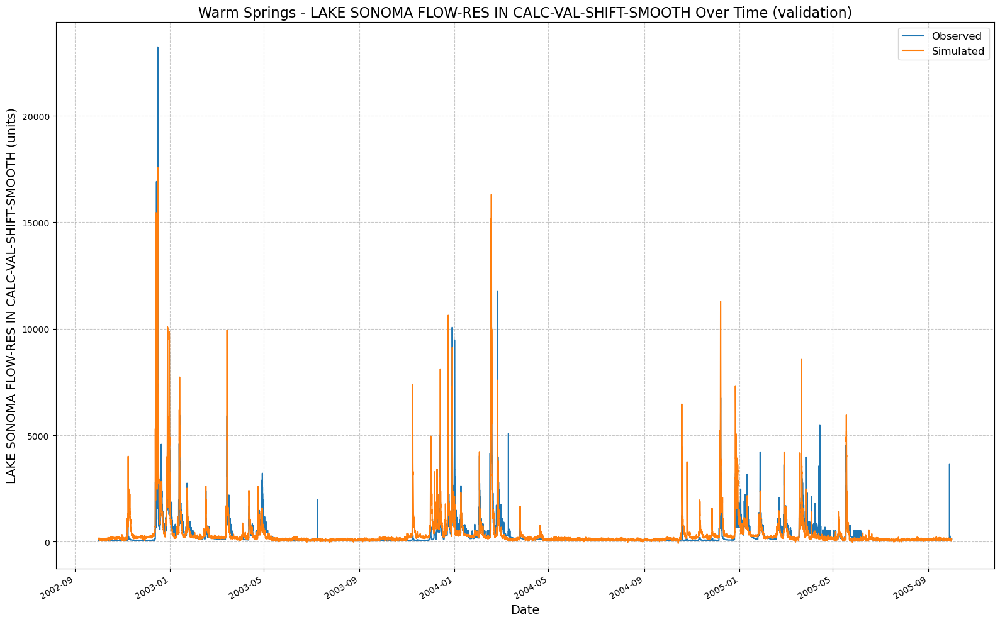

[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_103222\results_output_validation.csv
NoPhysics: {'hidden_size': 256, 'seq_length': 168, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 10:43:50,347: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_104350\output.log initialized.
2025-03-09 10:43:50,350: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_104350
2025-03-09 10:43:50,351: ### Run configurations for testing_run
2025-03-09 10:43:50,354: experiment_name: testing_run
2025-03-09 10:43:50,357: train_basin_file: warm springs
2025-03-09 10:43:50,360: validation_basin_file: warm springs


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


2025-03-09 10:43:50,362: test_basin_file: warm springs
2025-03-09 10:43:50,365: train_start_date: 1994-10-01 00:00:00
2025-03-09 10:43:50,367: train_end_date: 2002-09-30 00:00:00
2025-03-09 10:43:50,368: validation_start_date: 2002-10-01 00:00:00
2025-03-09 10:43:50,370: validation_end_date: 2005-09-30 00:00:00
2025-03-09 10:43:50,371: test_start_date: 2005-10-01 00:00:00
2025-03-09 10:43:50,373: test_end_date: 2009-09-29 00:00:00
2025-03-09 10:43:50,377: device: cuda:0
2025-03-09 10:43:50,379: physics_informed: False
2025-03-09 10:43:50,380: physics_data_file: None
2025-03-09 10:43:50,382: validate_every: 5
2025-03-09 10:43:50,383: validate_n_random_basins: 1
2025-03-09 10:43:50,385: metrics: ['NSE', 'MSE']
2025-03-09 10:43:50,387: model: cudalstm
2025-03-09 10:43:50,388: head: regression
2025-03-09 10:43:50,390: output_activation: linear
2025-03-09 10:43:50,391: hidden_size: 256
2025-03-09 10:43:50,393: initial_forget_bias: 3
2025-03-09 10:43:50,395: output_dropout: 0.4
2025-03-09 10

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.03s/it]
2025-03-09 10:53:09,012: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_104350\validation\model_epoch016\validation_metrics.csv
2025-03-09 10:53:09,042: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_104350\validation\model_epoch016\validation_results.p
got predictions


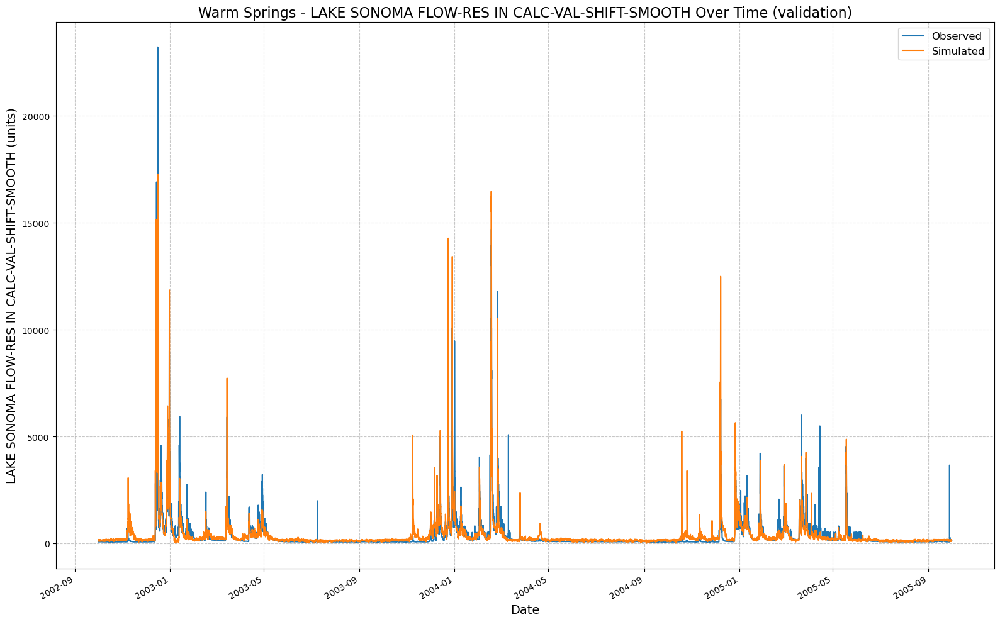

[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_104350\results_output_validation.csv
NoPhysics: {'hidden_size': 256, 'seq_length': 168, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 10:53:10,115: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_105310\output.log initialized.
2025-03-09 10:53:10,118: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_105310
2025-03-09 10:53:10,120: ### Run configurations for testing_run
2025-03-09 10:53:10,121: experiment_name: testing_run
2025-03-09 10:53:10,124: train_basin_file: warm springs
2025-03-09 10:53:10,128: validation_basin_file: warm springs
2025-03-09 10:53:10,130: test_basin_file: warm springs
2025-03-09 10:53:10,132: train_start_date: 1994-10-01 00:00:00
2025-03-09 10:53:10,134: train_end_date: 2002-09-30 00:00:00
2025-03-09 10:53:10,136: validation_

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


2025-03-09 10:53:10,142: test_end_date: 2009-09-29 00:00:00
2025-03-09 10:53:10,146: device: cuda:0
2025-03-09 10:53:10,148: physics_informed: False
2025-03-09 10:53:10,149: physics_data_file: None
2025-03-09 10:53:10,150: validate_every: 5
2025-03-09 10:53:10,153: validate_n_random_basins: 1
2025-03-09 10:53:10,155: metrics: ['NSE', 'MSE']
2025-03-09 10:53:10,158: model: cudalstm
2025-03-09 10:53:10,160: head: regression
2025-03-09 10:53:10,162: output_activation: linear
2025-03-09 10:53:10,164: hidden_size: 256
2025-03-09 10:53:10,165: initial_forget_bias: 3
2025-03-09 10:53:10,166: output_dropout: 0.4
2025-03-09 10:53:10,167: num_layers: 1
2025-03-09 10:53:10,168: dev_mode: True
2025-03-09 10:53:10,170: optimizer: Adam
2025-03-09 10:53:10,173: loss: NSE
2025-03-09 10:53:10,175: learning_rate: {0: 0.01, 20: 0.005, 30: 0.001}
2025-03-09 10:53:10,177: batch_size: 256
2025-03-09 10:53:10,179: epochs: 32
2025-03-09 10:53:10,180: clip_gradient_norm: 1
2025-03-09 10:53:10,181: predict_last

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.37s/it]
2025-03-09 11:11:33,720: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_105310\validation\model_epoch032\validation_metrics.csv
2025-03-09 11:11:33,728: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_105310\validation\model_epoch032\validation_results.p
got predictions


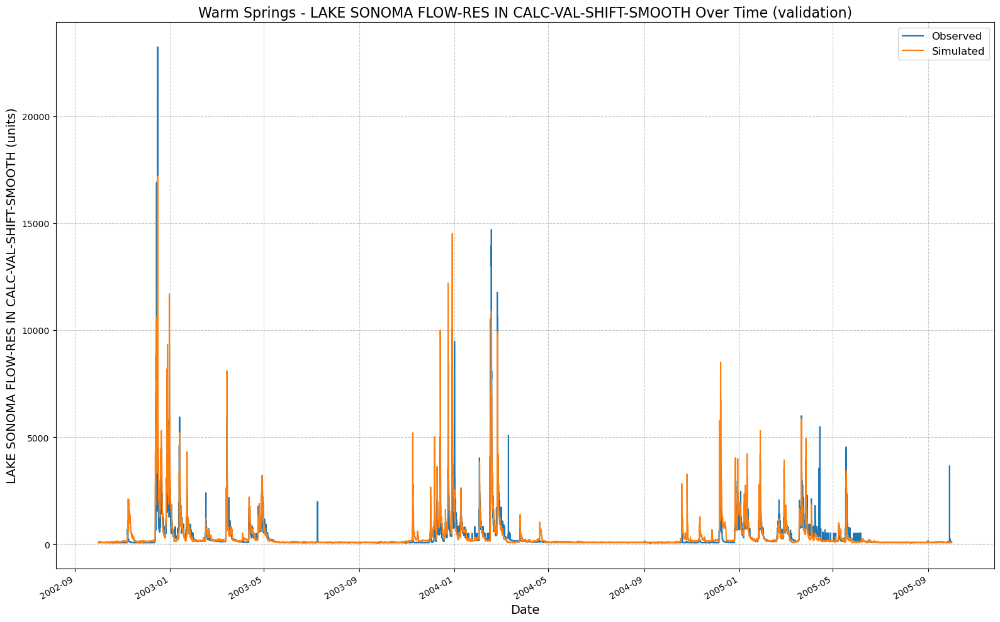

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_105310\results_output_validation.csv
NoPhysics: {'hidden_size': 256, 'seq_length': 336, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 11:11:34,821: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_111134\output.log initialized.
2025-03-09 11:11:34,822: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_111134
2025-03-09 11:11:34,823: ### Run configurations for testing_run
2025-03-09 11:11:34,825: experiment_name: testing_run
2025-03-09 11:11:34,826: train_basin_file: warm springs
2025-03-09 11:11:34,826: validation_basin_file: warm springs
2025-03-09 11:11:34,828: test_basin_file: warm springs
2025-03-09 11:11:34,829: train_start_date: 1994-10-01 00:00:00
2025-03-09 11:11:34,830: train_end_date: 2002-09-30 00:00:00
2025-03-09 11:11:34,832: validation_

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:11<00:00, 11.44s/it]
2025-03-09 11:28:23,101: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_111134\validation\model_epoch016\validation_metrics.csv
2025-03-09 11:28:23,112: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_111134\validation\model_epoch016\validation_results.p
got predictions


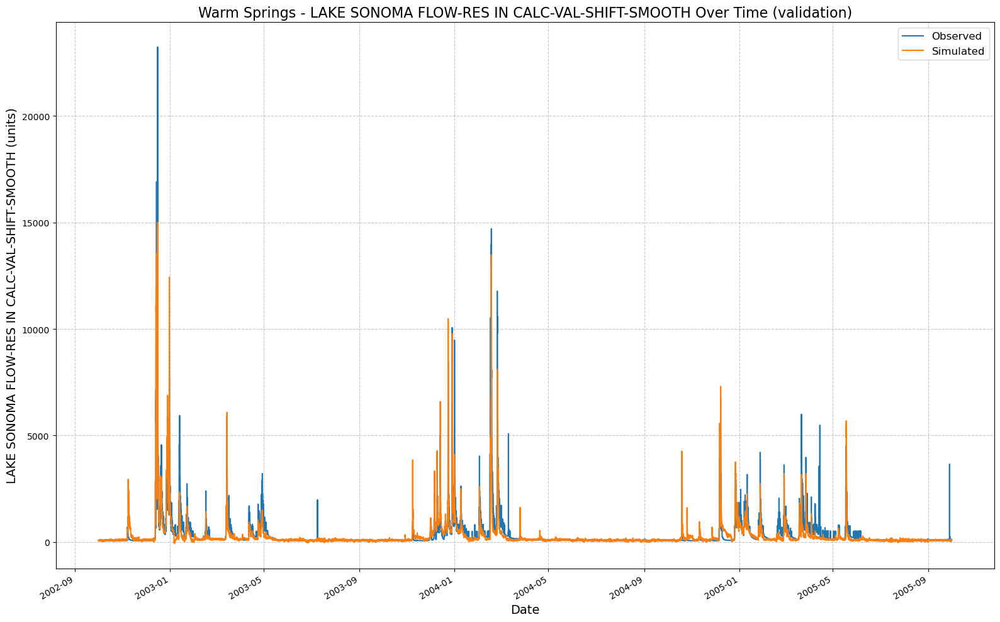

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_111134\results_output_validation.csv
NoPhysics: {'hidden_size': 256, 'seq_length': 336, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 11:28:24,211: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_112824\output.log initialized.
2025-03-09 11:28:24,214: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_112824
2025-03-09 11:28:24,217: ### Run configurations for testing_run
2025-03-09 11:28:24,219: experiment_name: testing_run
2025-03-09 11:28:24,221: train_basin_file: warm springs
2025-03-09 11:28:24,225: validation_basin_file: warm springs
2025-03-09 11:28:24,228: test_basin_file: warm springs
2025-03-09 11:28:24,232: train_start_date: 1994-10-01 00:00:00
2025-03-09 11:28:24,234: train_end_date: 2002-09-30 00:00:00
2025-03-09 11:28:24,237: validation_

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:11<00:00, 11.18s/it]
2025-03-09 12:01:38,582: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_112824\validation\model_epoch032\validation_metrics.csv
2025-03-09 12:01:38,596: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_112824\validation\model_epoch032\validation_results.p
got predictions


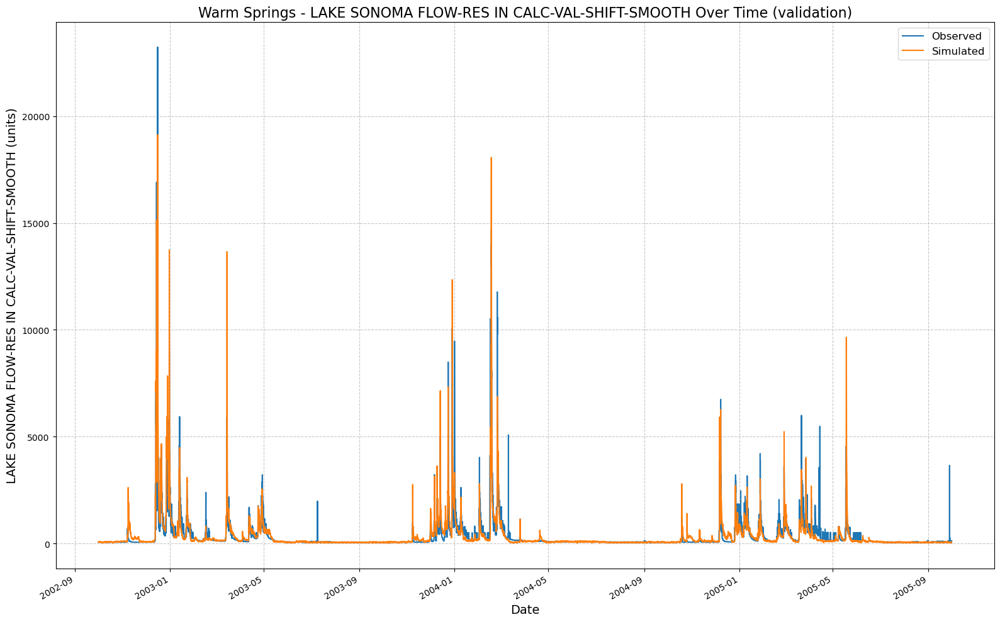

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_112824\results_output_validation.csv


In [10]:
if run_gridsearch or not os.path.exists(hyperparam_csv_file):
    for (hs, seq, nl, ep) in itertools.product(
            hyperparam_space["hidden_size"],
            hyperparam_space["seq_length"],
            hyperparam_space["num_layers"],
            hyperparam_space["epochs"]
    ):
        hp = {
            "hidden_size": hs,
            "seq_length": seq,
            "num_layers": nl,
            "epochs": ep,
            "output_dropout": fixed_dropout,
        }
        print(f"NoPhysics: {hp}")
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp,
            input_features=None,
            physics_informed=False,
            physics_data_file=None,
            hourly=True,
            extend_train_period=False,
            gpu=0
        )
        trainer.train()
        csv_path, metrics_dict = trainer.results()
        row_data = {"hidden_size": hs, "seq_length": seq, "num_layers": nl, "epochs": ep, "output_dropout": fixed_dropout}
        for k, v in metrics_dict.items():
            row_data[k] = v
        no_physics_results.append(row_data)
    df_no_physics = pd.DataFrame(no_physics_results)
    df_no_physics.sort_values(by="NSE", ascending=False, inplace=True)
    df_no_physics.reset_index(drop=True, inplace=True)
else:
    print("Skipping Grid-Search")

Physics: {'hidden_size': 64, 'seq_length': 90, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 12:01:39,748: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120139\output.log initialized.
2025-03-09 12:01:39,750: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120139
2025-03-09 12:01:39,751: ### Run configurations for testing_run
2025-03-09 12:01:39,752: experiment_name: testing_run
2025-03-09 12:01:39,754: train_basin_file: warm springs
2025-03-09 12:01:39,755: validation_basin_file: warm springs
2025-03-09 12:01:39,757: test_basin_file: warm springs
2025-03-09 12:01:39,757: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:01:39,758: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:01:39,759: validation_start_date: 2002-10-01 00:00:00
2025-03-09 12:01:39,761: validation_end_date: 2005-09-30 00:00:00
2025-03-09 12:01:39,762: test_start_date: 2005-10-01 0

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.89s/it]
2025-03-09 12:04:36,577: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120139\validation\model_epoch016\validation_metrics.csv
2025-03-09 12:04:36,593: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120139\validation\model_epoch016\validation_results.p
got predictions


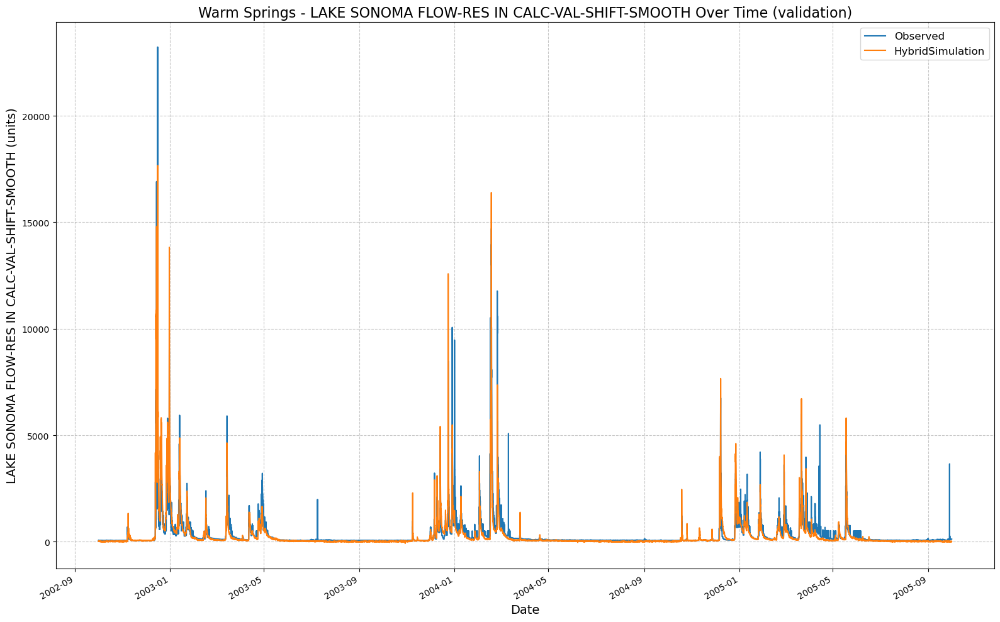

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120139\results_output_validation.csv
Physics: {'hidden_size': 64, 'seq_length': 90, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 12:04:37,708: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120437\output.log initialized.
2025-03-09 12:04:37,710: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120437
2025-03-09 12:04:37,712: ### Run configurations for testing_run
2025-03-09 12:04:37,714: experiment_name: testing_run
2025-03-09 12:04:37,717: train_basin_file: warm springs
2025-03-09 12:04:37,719: validation_basin_file: warm springs
2025-03-09 12:04:37,721: test_basin_file: warm springs
2025-03-09 12:04:37,723: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:04:37,725: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:04:37,727: validation_star

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.42s/it]
2025-03-09 12:10:06,146: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120437\validation\model_epoch032\validation_metrics.csv
2025-03-09 12:10:06,162: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120437\validation\model_epoch032\validation_results.p
got predictions


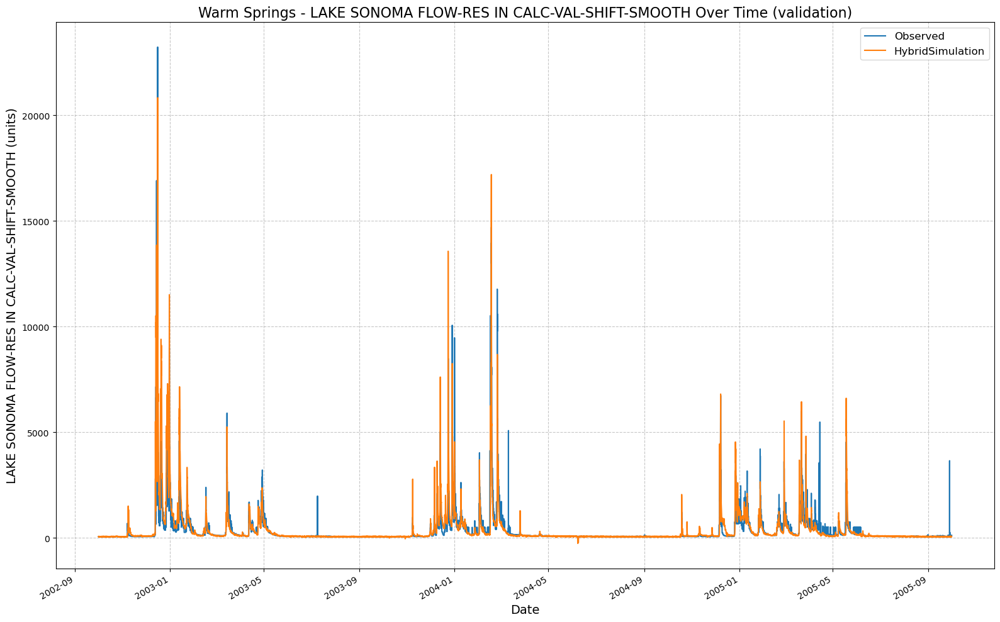

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_120437\results_output_validation.csv
Physics: {'hidden_size': 64, 'seq_length': 168, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 12:10:07,350: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121007\output.log initialized.
2025-03-09 12:10:07,352: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121007
2025-03-09 12:10:07,353: ### Run configurations for testing_run
2025-03-09 12:10:07,355: experiment_name: testing_run
2025-03-09 12:10:07,358: train_basin_file: warm springs
2025-03-09 12:10:07,360: validation_basin_file: warm springs
2025-03-09 12:10:07,364: test_basin_file: warm springs
2025-03-09 12:10:07,368: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:10:07,370: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:10:07,372: validation_sta

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.24s/it]
2025-03-09 12:13:45,880: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121007\validation\model_epoch016\validation_metrics.csv
2025-03-09 12:13:45,895: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121007\validation\model_epoch016\validation_results.p
got predictions


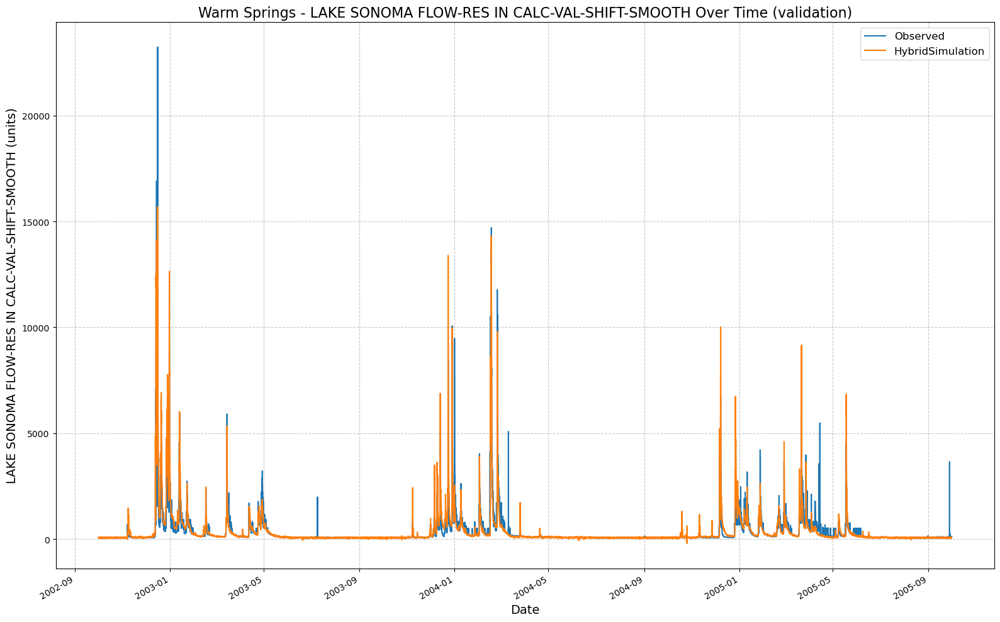

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121007\results_output_validation.csv
Physics: {'hidden_size': 64, 'seq_length': 168, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 12:13:47,062: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121347\output.log initialized.
2025-03-09 12:13:47,064: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121347
2025-03-09 12:13:47,067: ### Run configurations for testing_run
2025-03-09 12:13:47,070: experiment_name: testing_run
2025-03-09 12:13:47,072: train_basin_file: warm springs
2025-03-09 12:13:47,075: validation_basin_file: warm springs
2025-03-09 12:13:47,077: test_basin_file: warm springs
2025-03-09 12:13:47,081: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:13:47,084: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:13:47,087: validation_sta

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.16s/it]
2025-03-09 12:20:42,599: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121347\validation\model_epoch032\validation_metrics.csv
2025-03-09 12:20:42,612: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121347\validation\model_epoch032\validation_results.p
got predictions


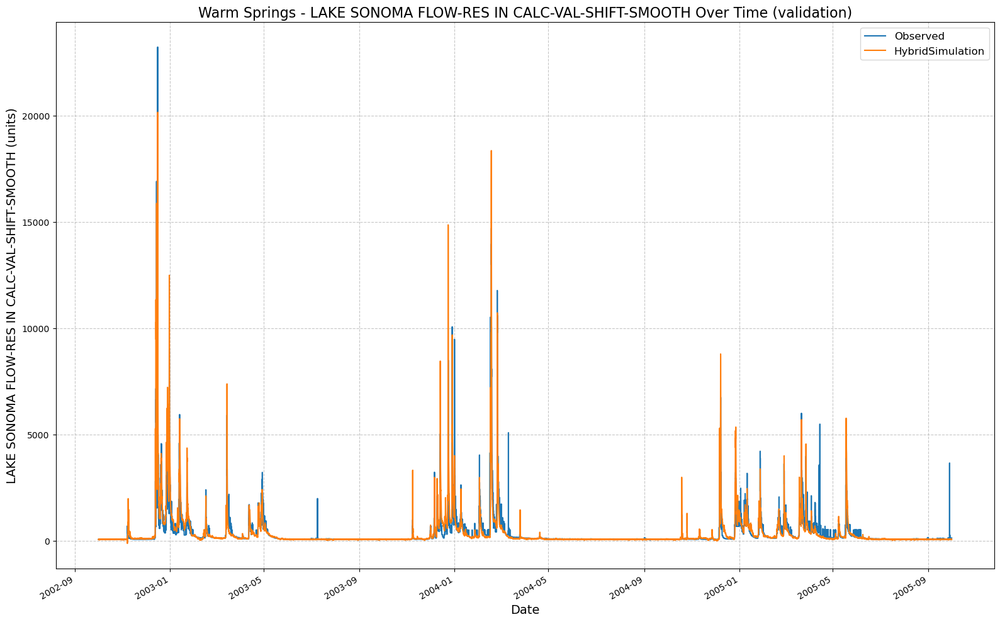

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_121347\results_output_validation.csv
Physics: {'hidden_size': 64, 'seq_length': 336, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 12:20:43,605: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122043\output.log initialized.
2025-03-09 12:20:43,607: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122043
2025-03-09 12:20:43,609: ### Run configurations for testing_run
2025-03-09 12:20:43,610: experiment_name: testing_run
2025-03-09 12:20:43,613: train_basin_file: warm springs
2025-03-09 12:20:43,615: validation_basin_file: warm springs
2025-03-09 12:20:43,617: test_basin_file: warm springs
2025-03-09 12:20:43,620: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:20:43,622: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:20:43,624: validation_sta

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.69s/it]
2025-03-09 12:26:02,786: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122043\validation\model_epoch016\validation_metrics.csv
2025-03-09 12:26:02,792: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122043\validation\model_epoch016\validation_results.p
got predictions


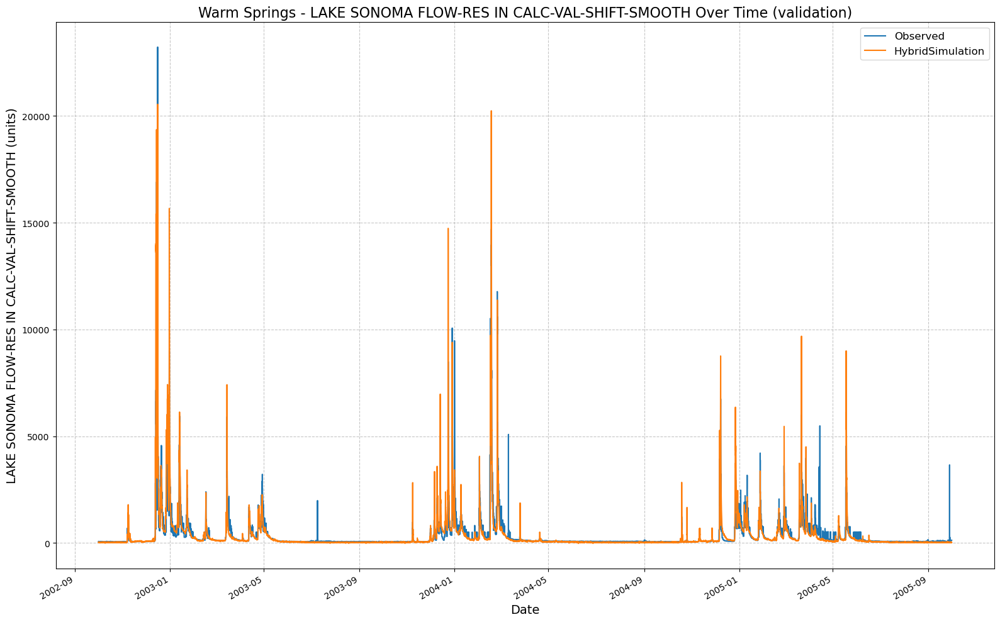

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122043\results_output_validation.csv
Physics: {'hidden_size': 64, 'seq_length': 336, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 12:26:03,986: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122603\output.log initialized.
2025-03-09 12:26:03,988: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122603
2025-03-09 12:26:03,990: ### Run configurations for testing_run
2025-03-09 12:26:03,992: experiment_name: testing_run
2025-03-09 12:26:03,993: train_basin_file: warm springs
2025-03-09 12:26:03,994: validation_basin_file: warm springs
2025-03-09 12:26:03,995: test_basin_file: warm springs
2025-03-09 12:26:03,996: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:26:03,997: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:26:03,998: validation_sta

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:09<00:00,  9.67s/it]
2025-03-09 12:36:09,002: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122603\validation\model_epoch032\validation_metrics.csv
2025-03-09 12:36:09,010: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122603\validation\model_epoch032\validation_results.p
got predictions


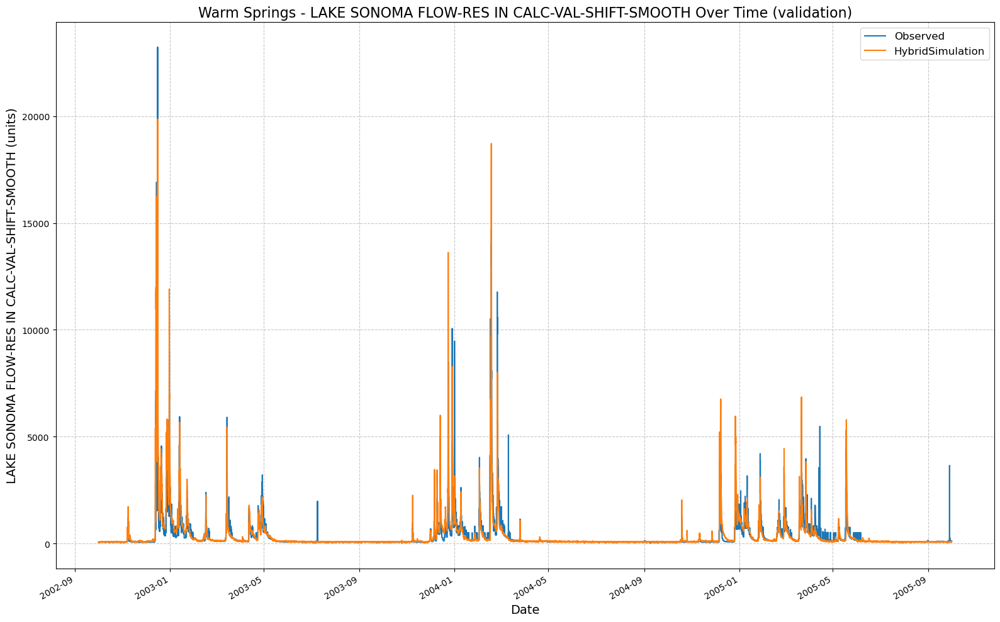

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_122603\results_output_validation.csv
Physics: {'hidden_size': 128, 'seq_length': 90, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 12:36:10,345: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_123610\output.log initialized.
2025-03-09 12:36:10,347: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_123610
2025-03-09 12:36:10,350: ### Run configurations for testing_run
2025-03-09 12:36:10,352: experiment_name: testing_run
2025-03-09 12:36:10,354: train_basin_file: warm springs
2025-03-09 12:36:10,355: validation_basin_file: warm springs
2025-03-09 12:36:10,357: test_basin_file: warm springs
2025-03-09 12:36:10,359: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:36:10,360: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:36:10,362: validation_sta

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:09<00:00,  9.13s/it]
2025-03-09 12:41:33,580: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_123610\validation\model_epoch016\validation_metrics.csv
2025-03-09 12:41:33,588: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_123610\validation\model_epoch016\validation_results.p
got predictions


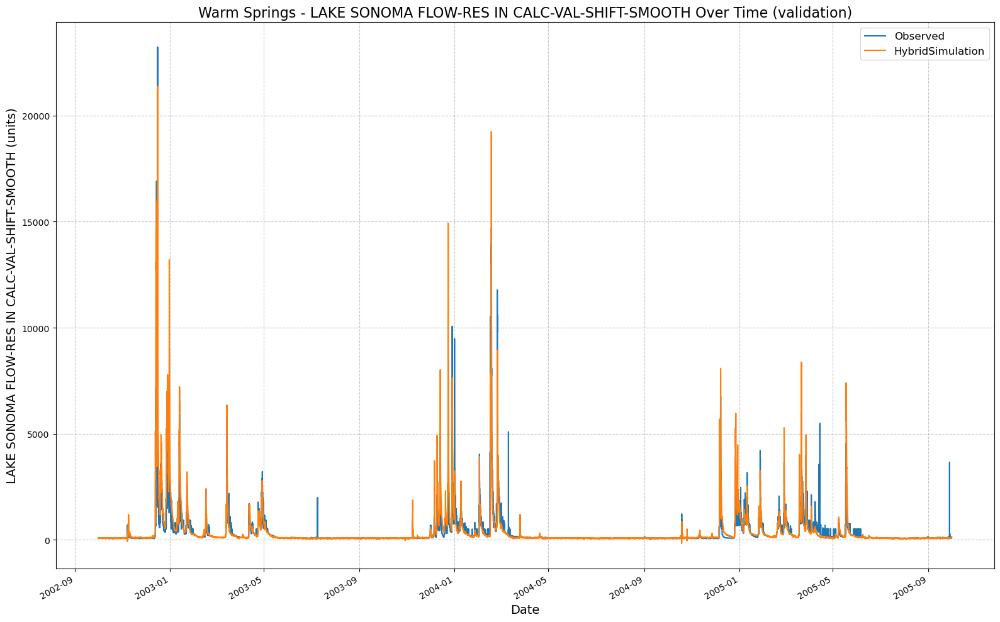

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_123610\results_output_validation.csv
Physics: {'hidden_size': 128, 'seq_length': 90, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 12:41:34,976: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_124134\output.log initialized.
2025-03-09 12:41:34,978: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_124134
2025-03-09 12:41:34,979: ### Run configurations for testing_run
2025-03-09 12:41:34,980: experiment_name: testing_run
2025-03-09 12:41:34,981: train_basin_file: warm springs
2025-03-09 12:41:34,982: validation_basin_file: warm springs
2025-03-09 12:41:34,983: test_basin_file: warm springs
2025-03-09 12:41:34,984: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:41:34,985: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:41:34,986: validation_sta

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:09<00:00,  9.18s/it]
2025-03-09 12:51:55,898: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_124134\validation\model_epoch032\validation_metrics.csv
2025-03-09 12:51:55,907: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_124134\validation\model_epoch032\validation_results.p
got predictions


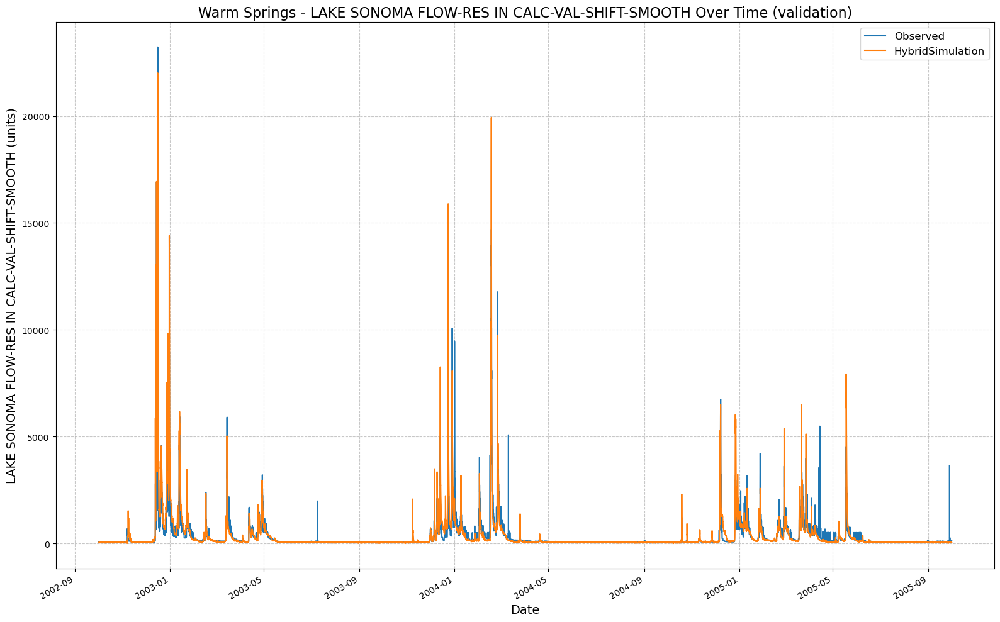

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_124134\results_output_validation.csv
Physics: {'hidden_size': 128, 'seq_length': 168, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 12:51:57,166: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_125157\output.log initialized.
2025-03-09 12:51:57,168: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_125157
2025-03-09 12:51:57,168: ### Run configurations for testing_run
2025-03-09 12:51:57,169: experiment_name: testing_run
2025-03-09 12:51:57,171: train_basin_file: warm springs
2025-03-09 12:51:57,172: validation_basin_file: warm springs
2025-03-09 12:51:57,175: test_basin_file: warm springs
2025-03-09 12:51:57,177: train_start_date: 1994-10-01 00:00:00
2025-03-09 12:51:57,179: train_end_date: 2002-09-30 00:00:00
2025-03-09 12:51:57,181: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:11<00:00, 11.19s/it]
2025-03-09 13:00:09,739: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_125157\validation\model_epoch016\validation_metrics.csv
2025-03-09 13:00:09,747: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_125157\validation\model_epoch016\validation_results.p
got predictions


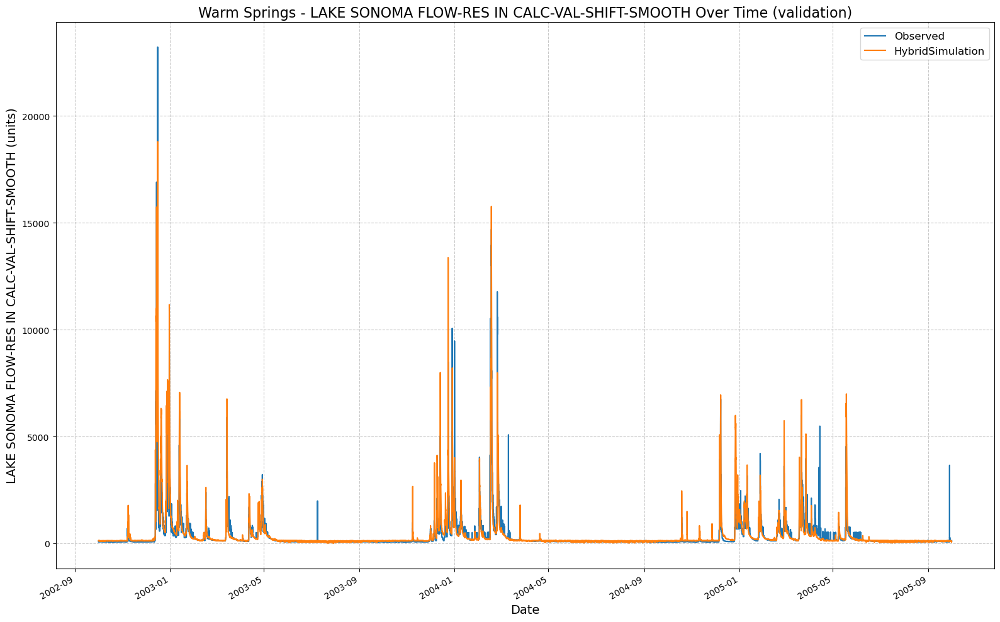

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_125157\results_output_validation.csv
Physics: {'hidden_size': 128, 'seq_length': 168, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 13:00:10,999: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_130010\output.log initialized.
2025-03-09 13:00:11,001: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_130010
2025-03-09 13:00:11,003: ### Run configurations for testing_run
2025-03-09 13:00:11,004: experiment_name: testing_run
2025-03-09 13:00:11,006: train_basin_file: warm springs
2025-03-09 13:00:11,008: validation_basin_file: warm springs
2025-03-09 13:00:11,010: test_basin_file: warm springs
2025-03-09 13:00:11,012: train_start_date: 1994-10-01 00:00:00
2025-03-09 13:00:11,014: train_end_date: 2002-09-30 00:00:00
2025-03-09 13:00:11,016: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:11<00:00, 11.19s/it]
2025-03-09 13:16:07,700: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_130010\validation\model_epoch032\validation_metrics.csv
2025-03-09 13:16:07,710: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_130010\validation\model_epoch032\validation_results.p
got predictions


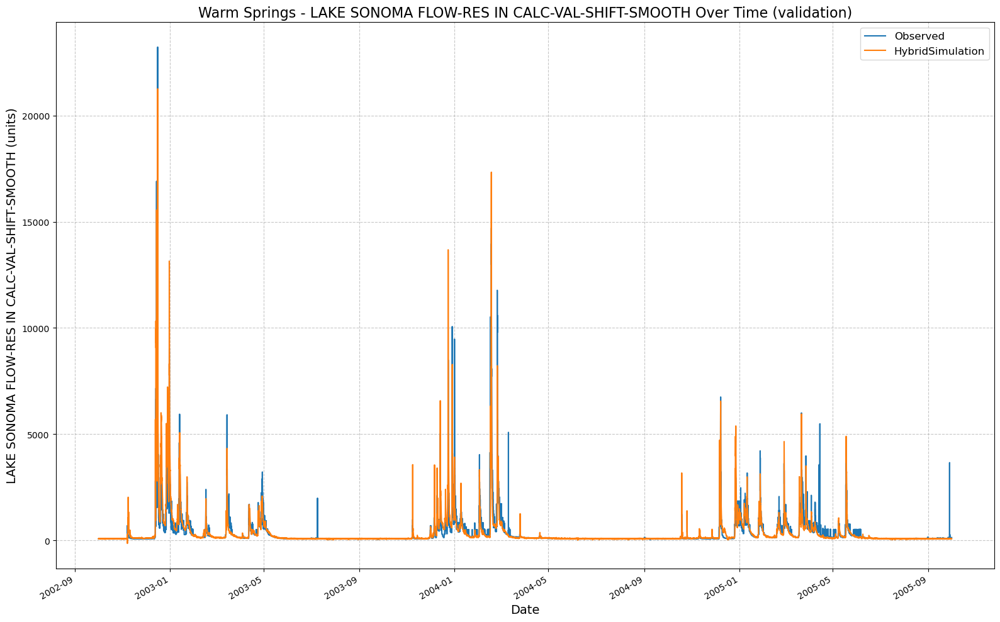

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_130010\results_output_validation.csv
Physics: {'hidden_size': 128, 'seq_length': 336, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 13:16:08,921: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_131608\output.log initialized.
2025-03-09 13:16:08,923: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_131608
2025-03-09 13:16:08,925: ### Run configurations for testing_run
2025-03-09 13:16:08,926: experiment_name: testing_run
2025-03-09 13:16:08,928: train_basin_file: warm springs
2025-03-09 13:16:08,931: validation_basin_file: warm springs
2025-03-09 13:16:08,933: test_basin_file: warm springs
2025-03-09 13:16:08,934: train_start_date: 1994-10-01 00:00:00
2025-03-09 13:16:08,936: train_end_date: 2002-09-30 00:00:00
2025-03-09 13:16:08,939: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:13<00:00, 13.81s/it]
2025-03-09 13:30:14,567: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_131608\validation\model_epoch016\validation_metrics.csv
2025-03-09 13:30:14,575: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_131608\validation\model_epoch016\validation_results.p
got predictions


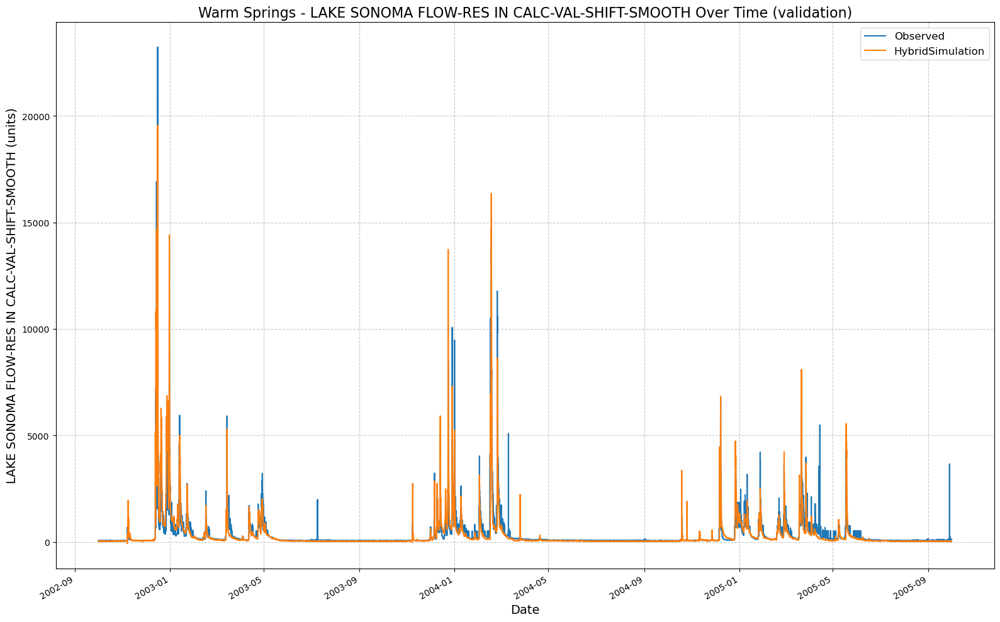

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_131608\results_output_validation.csv
Physics: {'hidden_size': 128, 'seq_length': 336, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 13:30:15,756: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_133015\output.log initialized.
2025-03-09 13:30:15,758: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_133015
2025-03-09 13:30:15,761: ### Run configurations for testing_run
2025-03-09 13:30:15,763: experiment_name: testing_run
2025-03-09 13:30:15,765: train_basin_file: warm springs
2025-03-09 13:30:15,767: validation_basin_file: warm springs
2025-03-09 13:30:15,768: test_basin_file: warm springs
2025-03-09 13:30:15,771: train_start_date: 1994-10-01 00:00:00
2025-03-09 13:30:15,772: train_end_date: 2002-09-30 00:00:00
2025-03-09 13:30:15,774: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:14<00:00, 14.34s/it]
2025-03-09 13:58:06,113: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_133015\validation\model_epoch032\validation_metrics.csv
2025-03-09 13:58:06,124: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_133015\validation\model_epoch032\validation_results.p
got predictions


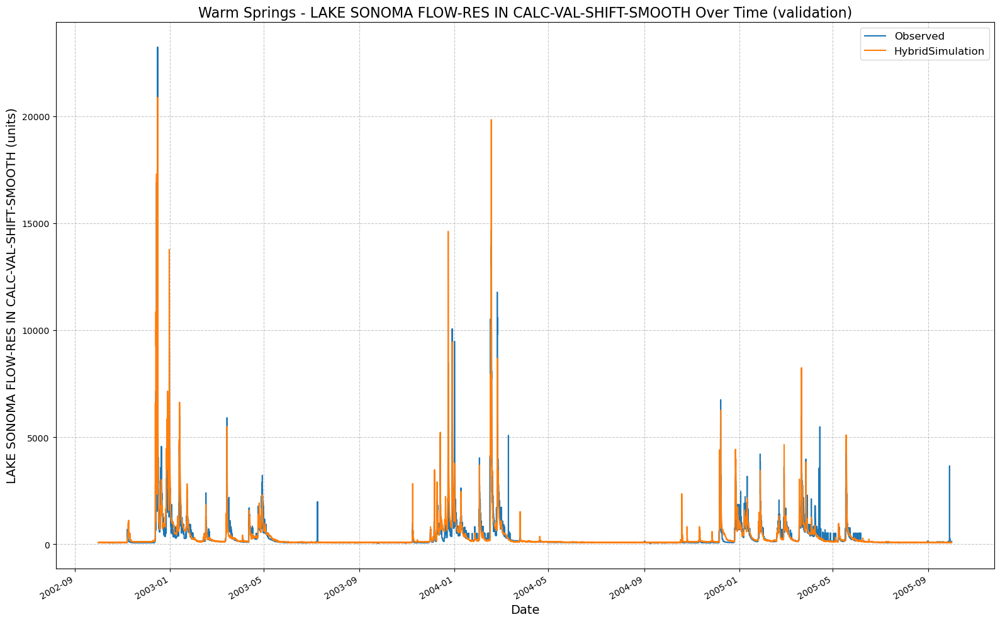

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_133015\results_output_validation.csv
Physics: {'hidden_size': 256, 'seq_length': 90, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 13:58:07,411: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_135807\output.log initialized.
2025-03-09 13:58:07,413: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_135807
2025-03-09 13:58:07,415: ### Run configurations for testing_run
2025-03-09 13:58:07,418: experiment_name: testing_run
2025-03-09 13:58:07,419: train_basin_file: warm springs
2025-03-09 13:58:07,421: validation_basin_file: warm springs
2025-03-09 13:58:07,421: test_basin_file: warm springs
2025-03-09 13:58:07,423: train_start_date: 1994-10-01 00:00:00
2025-03-09 13:58:07,424: train_end_date: 2002-09-30 00:00:00
2025-03-09 13:58:07,425: validation_sta

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:09<00:00,  9.43s/it]
2025-03-09 14:04:05,902: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_135807\validation\model_epoch016\validation_metrics.csv
2025-03-09 14:04:05,911: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_135807\validation\model_epoch016\validation_results.p
got predictions


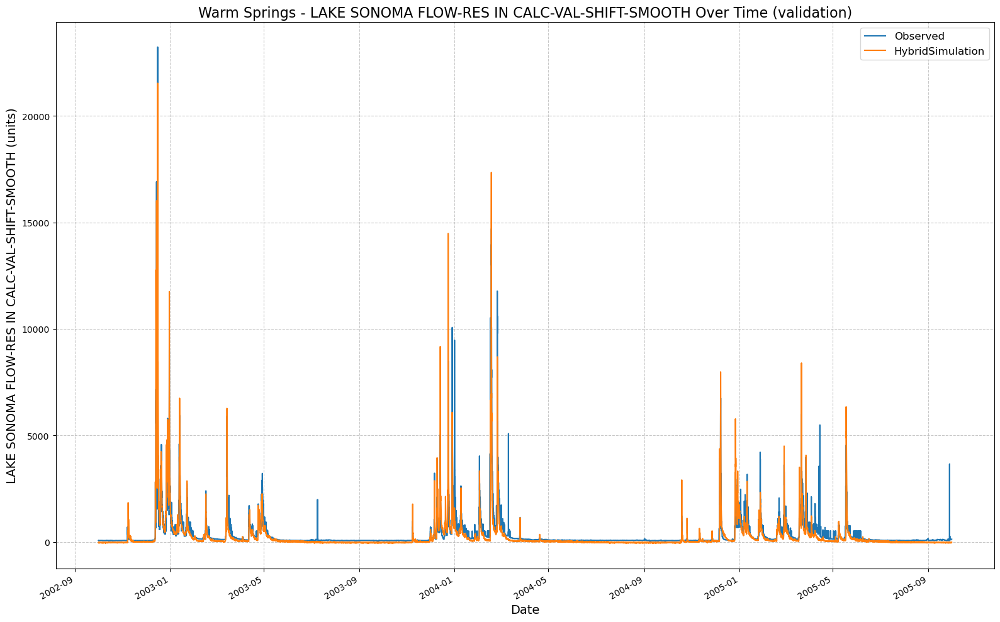

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_135807\results_output_validation.csv
Physics: {'hidden_size': 256, 'seq_length': 90, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 14:04:07,103: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_140407\output.log initialized.
2025-03-09 14:04:07,105: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_140407
2025-03-09 14:04:07,107: ### Run configurations for testing_run
2025-03-09 14:04:07,108: experiment_name: testing_run
2025-03-09 14:04:07,109: train_basin_file: warm springs
2025-03-09 14:04:07,110: validation_basin_file: warm springs
2025-03-09 14:04:07,112: test_basin_file: warm springs
2025-03-09 14:04:07,113: train_start_date: 1994-10-01 00:00:00
2025-03-09 14:04:07,114: train_end_date: 2002-09-30 00:00:00
2025-03-09 14:04:07,116: validation_sta

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:09<00:00,  9.09s/it]
2025-03-09 14:15:39,330: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_140407\validation\model_epoch032\validation_metrics.csv
2025-03-09 14:15:39,336: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_140407\validation\model_epoch032\validation_results.p
got predictions


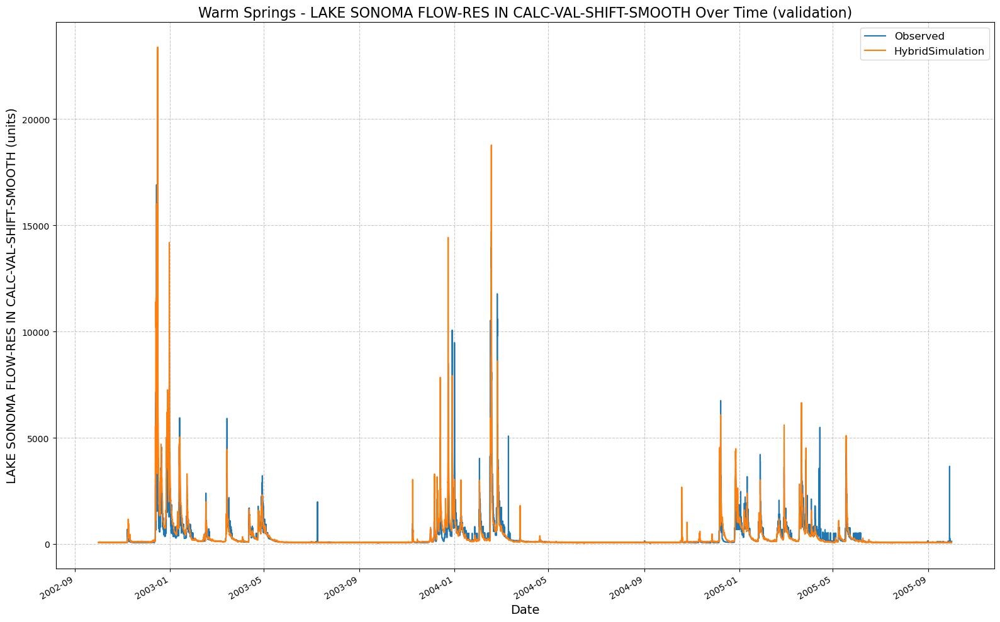

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_140407\results_output_validation.csv
Physics: {'hidden_size': 256, 'seq_length': 168, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 14:15:40,527: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_141540\output.log initialized.
2025-03-09 14:15:40,529: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_141540
2025-03-09 14:15:40,531: ### Run configurations for testing_run
2025-03-09 14:15:40,532: experiment_name: testing_run
2025-03-09 14:15:40,533: train_basin_file: warm springs
2025-03-09 14:15:40,534: validation_basin_file: warm springs
2025-03-09 14:15:40,536: test_basin_file: warm springs
2025-03-09 14:15:40,537: train_start_date: 1994-10-01 00:00:00
2025-03-09 14:15:40,538: train_end_date: 2002-09-30 00:00:00
2025-03-09 14:15:40,539: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:10<00:00, 10.51s/it]
2025-03-09 14:25:09,898: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_141540\validation\model_epoch016\validation_metrics.csv
2025-03-09 14:25:09,905: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_141540\validation\model_epoch016\validation_results.p
got predictions


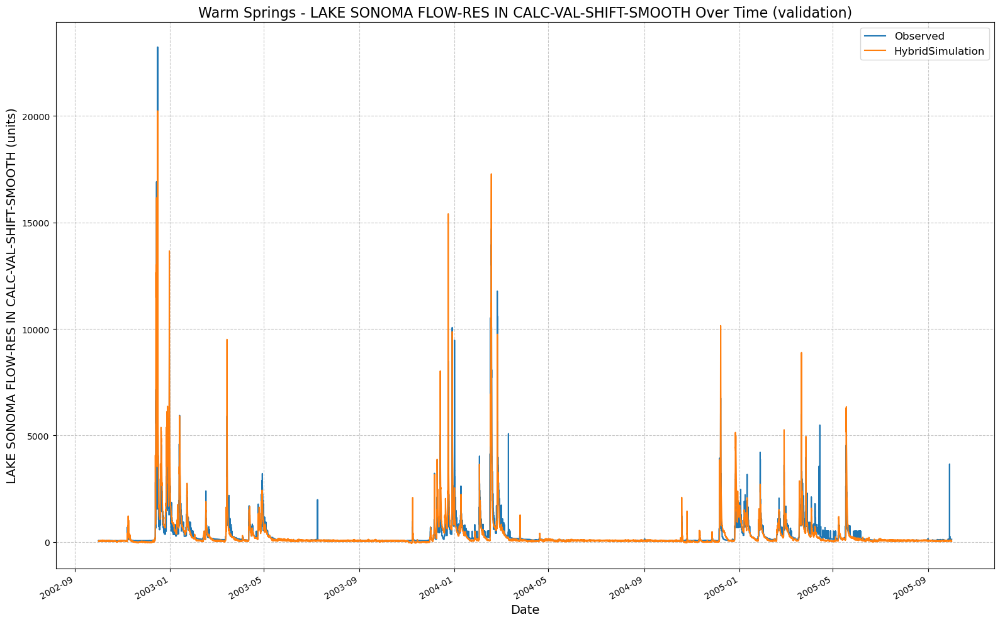

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_141540\results_output_validation.csv
Physics: {'hidden_size': 256, 'seq_length': 168, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 14:25:11,086: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_142511\output.log initialized.
2025-03-09 14:25:11,088: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_142511
2025-03-09 14:25:11,091: ### Run configurations for testing_run
2025-03-09 14:25:11,094: experiment_name: testing_run
2025-03-09 14:25:11,096: train_basin_file: warm springs
2025-03-09 14:25:11,097: validation_basin_file: warm springs
2025-03-09 14:25:11,098: test_basin_file: warm springs
2025-03-09 14:25:11,099: train_start_date: 1994-10-01 00:00:00
2025-03-09 14:25:11,102: train_end_date: 2002-09-30 00:00:00
2025-03-09 14:25:11,104: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:10<00:00, 10.72s/it]
2025-03-09 14:43:43,260: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_142511\validation\model_epoch032\validation_metrics.csv
2025-03-09 14:43:43,268: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_142511\validation\model_epoch032\validation_results.p
got predictions


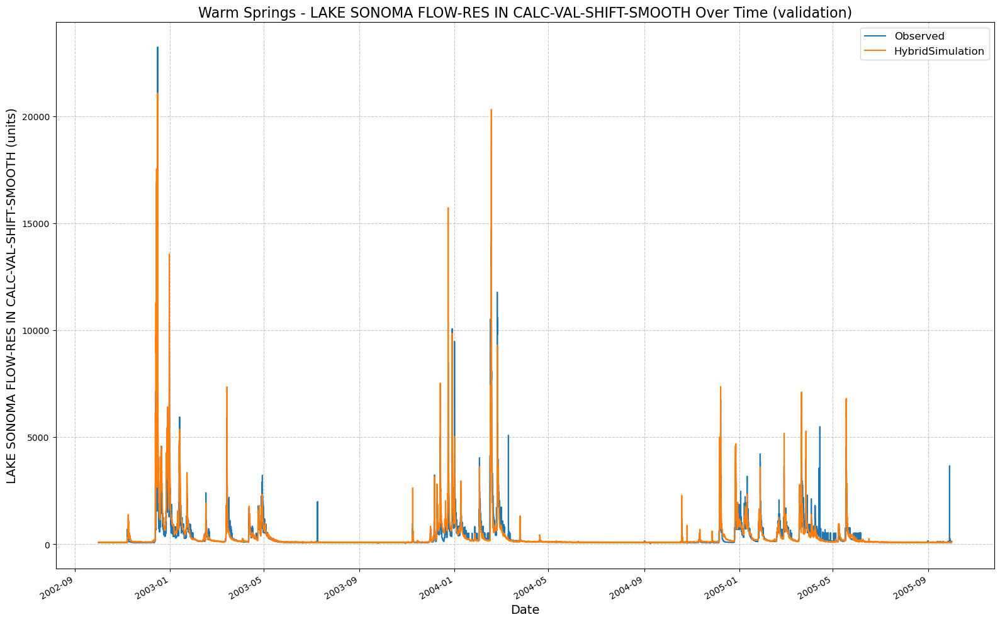

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_142511\results_output_validation.csv
Physics: {'hidden_size': 256, 'seq_length': 336, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-09 14:43:44,621: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_144344\output.log initialized.
2025-03-09 14:43:44,622: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_144344
2025-03-09 14:43:44,624: ### Run configurations for testing_run
2025-03-09 14:43:44,625: experiment_name: testing_run
2025-03-09 14:43:44,626: train_basin_file: warm springs
2025-03-09 14:43:44,628: validation_basin_file: warm springs
2025-03-09 14:43:44,630: test_basin_file: warm springs
2025-03-09 14:43:44,631: train_start_date: 1994-10-01 00:00:00
2025-03-09 14:43:44,633: train_end_date: 2002-09-30 00:00:00
2025-03-09 14:43:44,635: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:14<00:00, 14.21s/it]
2025-03-09 15:00:50,740: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_144344\validation\model_epoch016\validation_metrics.csv
2025-03-09 15:00:50,751: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_144344\validation\model_epoch016\validation_results.p
got predictions


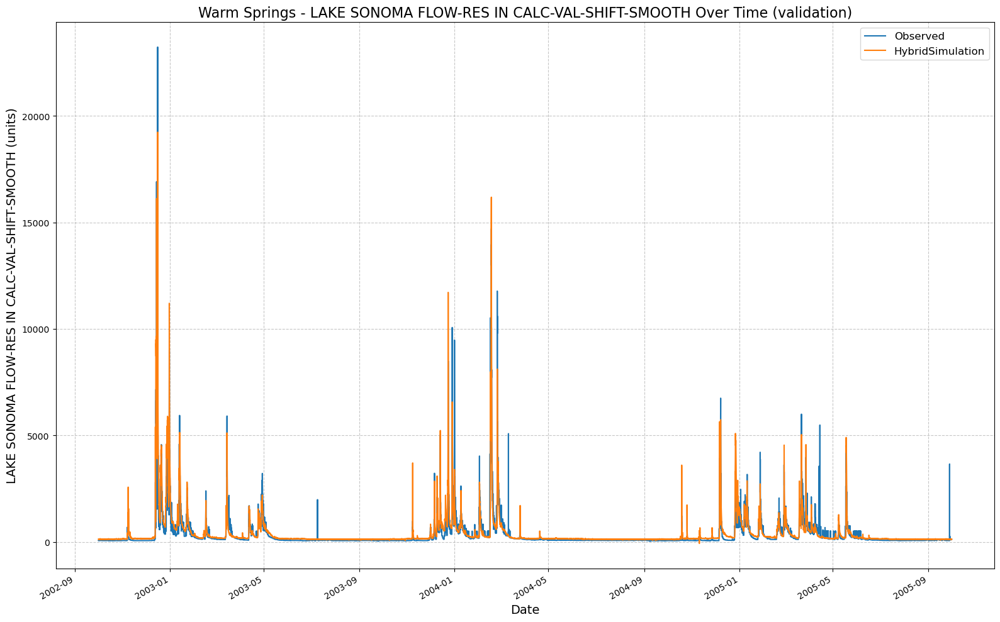

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_144344\results_output_validation.csv
Physics: {'hidden_size': 256, 'seq_length': 336, 'num_layers': 1, 'epochs': 32, 'output_dropout': 0.4}
2025-03-09 15:00:52,010: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_150051\output.log initialized.
2025-03-09 15:00:52,011: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_150051
2025-03-09 15:00:52,013: ### Run configurations for testing_run
2025-03-09 15:00:52,014: experiment_name: testing_run
2025-03-09 15:00:52,015: train_basin_file: warm springs
2025-03-09 15:00:52,016: validation_basin_file: warm springs
2025-03-09 15:00:52,017: test_basin_file: warm springs
2025-03-09 15:00:52,018: train_start_date: 1994-10-01 00:00:00
2025-03-09 15:00:52,019: train_end_date: 2002-09-30 00:00:00
2025-03-09 15:00:52,021: validation_st

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:13<00:00, 13.86s/it]
2025-03-09 15:34:33,393: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_150051\validation\model_epoch032\validation_metrics.csv
2025-03-09 15:34:33,403: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_150051\validation\model_epoch032\validation_results.p
got predictions


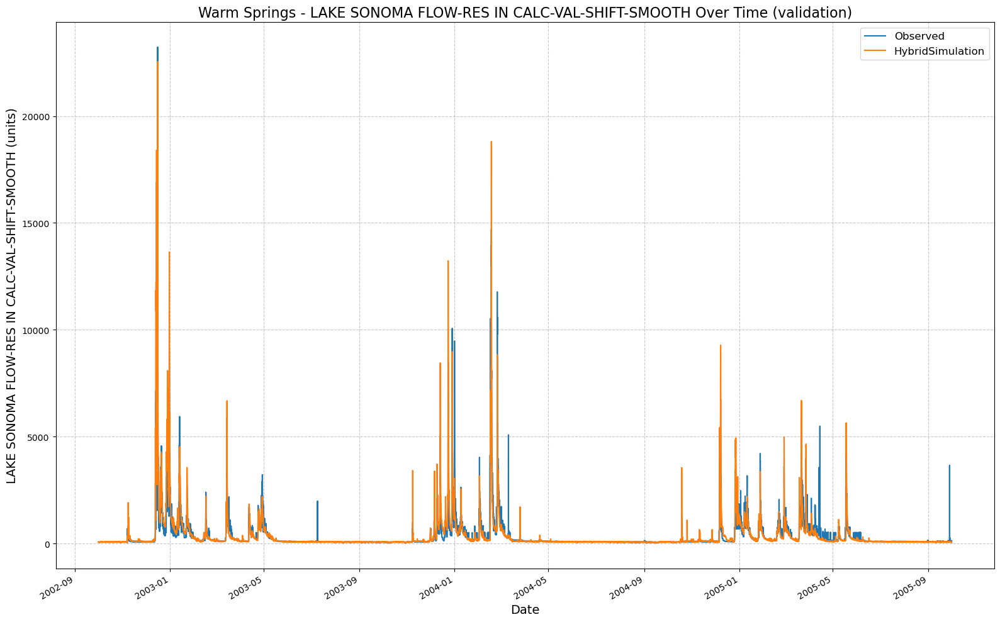

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_150051\results_output_validation.csv


In [11]:
if run_gridsearch or not os.path.exists(hyperparam_csv_file):
    for (hs, seq, nl, ep) in itertools.product(
            hyperparam_space["hidden_size"],
            hyperparam_space["seq_length"],
            hyperparam_space["num_layers"],
            hyperparam_space["epochs"]
    ):
        hp = {
            "hidden_size": hs,
            "seq_length": seq,
            "num_layers": nl,
            "epochs": ep,
            "output_dropout": fixed_dropout,
        }
        print(f"Physics: {hp}")
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp,
            input_features=features_with_physics,
            physics_informed=True,
            physics_data_file=path_to_physics_data,
            hourly=True,
            extend_train_period=False,
            gpu=0
        )
        trainer.train()
        csv_path, metrics_dict = trainer.results()
        row_data = {"hidden_size": hs, "seq_length": seq, "num_layers": nl, "epochs": ep, "output_dropout": fixed_dropout}
        for k, v in metrics_dict.items():
            row_data[k] = v
        physics_results.append(row_data)
    df_physics = pd.DataFrame(physics_results)
    df_physics.sort_values(by="NSE", ascending=False, inplace=True)
    df_physics.reset_index(drop=True, inplace=True)
    best_no_phys = df_no_physics.iloc[0].to_dict()
    best_phys = df_physics.iloc[0].to_dict()
    best_no_phys["model_type"] = "no_physics"
    best_phys["model_type"] = "physics"
    best_params_df = pd.DataFrame([best_no_phys, best_phys])
    best_params_df.to_csv(hyperparam_csv_file, index=False)
else:
    print("Skipping Grid-Search")

In [12]:
if os.path.exists(hyperparam_csv_file):
    best_params_df = pd.read_csv(hyperparam_csv_file)
    best_no_phys = best_params_df.query("model_type == 'no_physics'").iloc[0].to_dict()
    best_phys = best_params_df.query("model_type == 'physics'").iloc[0].to_dict()

    best_no_physics_params = {
        "epochs": int(best_no_phys["epochs"]),
        "hidden_size": int(best_no_phys["hidden_size"]),
        "seq_length": int(best_no_phys["seq_length"]),
        "num_layers": int(best_no_phys["num_layers"]),
        "output_dropout": float(best_no_phys["output_dropout"]),
    }

    best_physics_params = {
        "epochs": int(best_phys["epochs"]),
        "hidden_size": int(best_phys["hidden_size"]),
        "seq_length": int(best_phys["seq_length"]),
        "num_layers": int(best_phys["num_layers"]),
        "output_dropout": float(best_phys["output_dropout"]),
    }

In [13]:
if run_gridsearch:
    print(df_no_physics.iloc[0:9])
    df_no_physics.to_csv("warm_springs_hourly_no_physics_gridsearch.csv", index=False)

   hidden_size  seq_length  num_layers  epochs  output_dropout       NSE  \
0          128         168           1      32             0.4  0.795114   
1          256         336           1      16             0.4  0.793921   
2          256         336           1      32             0.4  0.776717   
3           64         336           1      32             0.4  0.765314   
4          128         336           1      32             0.4  0.741590   
5          128         336           1      16             0.4  0.740874   
6           64         168           1      32             0.4  0.730009   
7          256         168           1      16             0.4  0.726311   
8          256         168           1      32             0.4  0.721787   

             MSE        RMSE       KGE  Alpha-NSE  Beta-KGE  Beta-NSE  \
0  130018.796875  360.581193  0.881462   0.999938  1.060143  0.024577   
1  130775.757812  361.629310  0.857548   0.956645  0.915412 -0.034566   
2  141693.609375  37

In [14]:
if run_gridsearch:
    print(df_physics.iloc[0:9])
    df_physics.to_csv("warm_springs_hourly_physics_gridsearch.csv", index=False)

   hidden_size  seq_length  num_layers  epochs  output_dropout       NSE  \
0          256         336           1      16             0.4  0.831770   
1          128         168           1      32             0.4  0.818957   
2          128         336           1      32             0.4  0.818158   
3           64          90           1      16             0.4  0.817582   
4          256         168           1      32             0.4  0.816386   
5           64         168           1      32             0.4  0.807620   
6           64         336           1      32             0.4  0.807476   
7          128         336           1      16             0.4  0.802986   
8          256         336           1      32             0.4  0.795799   

             MSE        RMSE       KGE  Alpha-NSE  Beta-KGE  Beta-NSE  \
0  106757.078125  326.737017  0.722005   1.100817  1.250244  0.102261   
1  114888.476562  338.952027  0.820823   1.138049  1.089811  0.036701   
2  115395.250000  33

### Re-run validation with best hyperparameters

2025-03-09 15:34:34,759: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_153434\output.log initialized.
2025-03-09 15:34:34,761: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_153434
2025-03-09 15:34:34,764: ### Run configurations for testing_run
2025-03-09 15:34:34,765: experiment_name: testing_run
2025-03-09 15:34:34,767: train_basin_file: warm springs
2025-03-09 15:34:34,768: validation_basin_file: warm springs
2025-03-09 15:34:34,770: test_basin_file: warm springs
2025-03-09 15:34:34,771: train_start_date: 1994-10-01 00:00:00
2025-03-09 15:34:34,772: train_end_date: 2002-09-30 00:00:00
2025-03-09 15:34:34,777: validation_start_date: 2002-10-01 00:00:00
2025-03-09 15:34:34,780: validation_end_date: 2005-09-30 00:00:00
2025-03-09 15:34:34,782: test_start_date: 2005-10-01 00:00:00
2025-03-09 15:34:34,785: test_end_date: 2009-09-29 00:00:00
2025-03-09 15:34:34,788: device: 

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.94s/it]
2025-03-09 15:50:21,415: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_153434\validation\model_epoch032\validation_metrics.csv
2025-03-09 15:50:21,427: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_153434\validation\model_epoch032\validation_results.p
got predictions


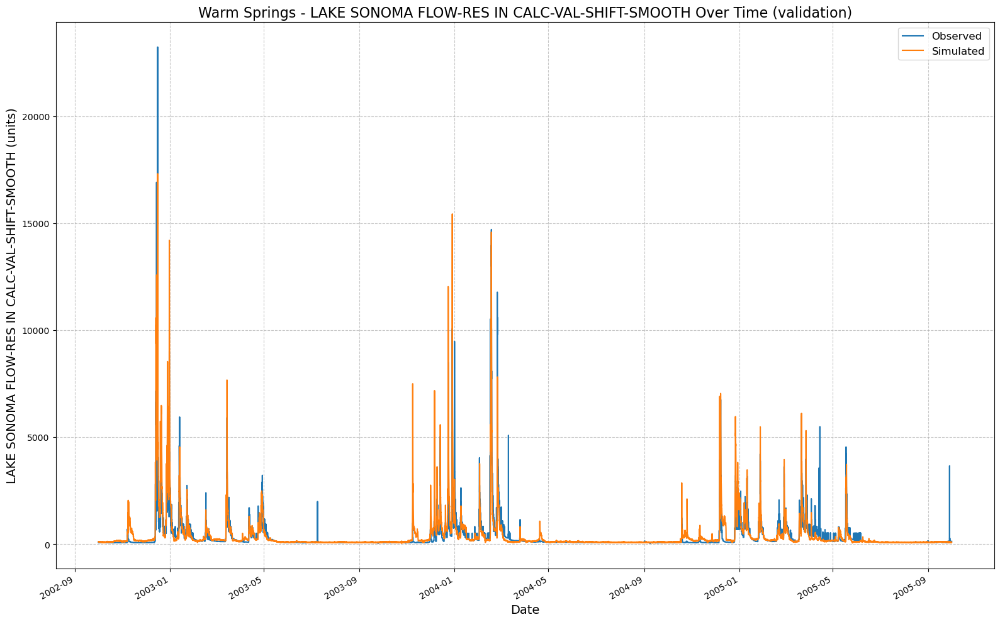

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_153434\results_output_validation.csv


In [16]:
if not skip_best_model_train:
    lstmNoPhysicsValBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=False,
        gpu=0
    )
    lstmNoPhysicsValBest.train()
    no_physics_val_csv, no_physics_val_metrics = lstmNoPhysicsValBest.results()
    no_physics_val_metrics

2025-03-09 15:50:22,773: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_155022\output.log initialized.
2025-03-09 15:50:22,776: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_155022
2025-03-09 15:50:22,779: ### Run configurations for testing_run
2025-03-09 15:50:22,781: experiment_name: testing_run
2025-03-09 15:50:22,783: train_basin_file: warm springs
2025-03-09 15:50:22,785: validation_basin_file: warm springs
2025-03-09 15:50:22,787: test_basin_file: warm springs
2025-03-09 15:50:22,789: train_start_date: 1994-10-01 00:00:00
2025-03-09 15:50:22,790: train_end_date: 2002-09-30 00:00:00
2025-03-09 15:50:22,792: validation_start_date: 2002-10-01 00:00:00
2025-03-09 15:50:22,794: validation_end_date: 2005-09-30 00:00:00
2025-03-09 15:50:22,795: test_start_date: 2005-10-01 00:00:00
2025-03-09 15:50:22,796: test_end_date: 2009-09-29 00:00:00
2025-03-09 15:50:22,797: device: 

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:14<00:00, 14.57s/it]
2025-03-09 16:07:52,167: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_155022\validation\model_epoch016\validation_metrics.csv
2025-03-09 16:07:52,173: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_155022\validation\model_epoch016\validation_results.p
got predictions


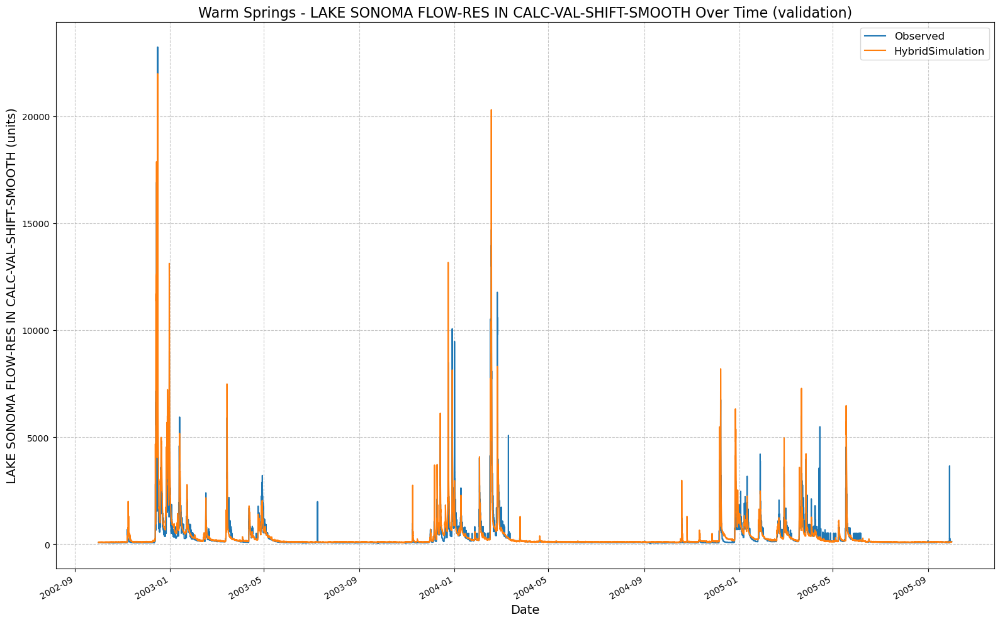

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_155022\results_output_validation.csv


In [17]:
if not skip_best_model_train:
    lstmPhysicsValBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data,
        hourly=True,
        extend_train_period=False,
        gpu=0
    )
    lstmPhysicsValBest.train()
    physics_val_csv, physics_val_metrics = lstmPhysicsValBest.results()
    physics_val_metrics

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:61: DtypeWarning: Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  hms_df = pd.read_csv(HMS_results)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is d

[INFO] Wrote metrics CSV: warm_springs_hourly_val_metrics.csv
[INFO] Saved figure: warm_springs_hourly_val_model_comparison.png


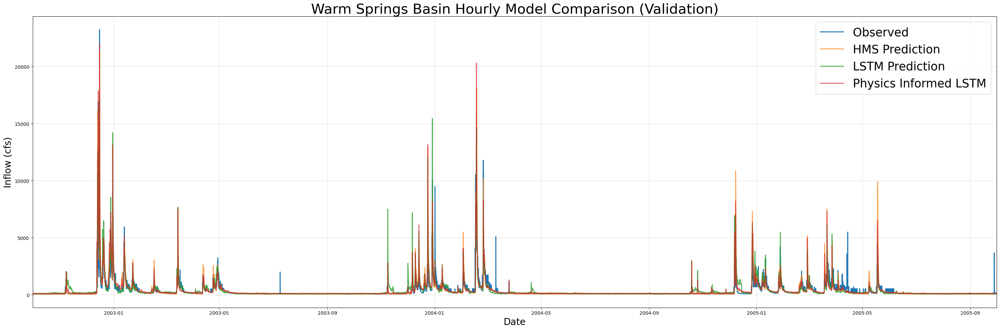

In [18]:
if not skip_best_model_train:
    combinedPlot(
        lstm_results=no_physics_val_csv,
        lstmPhysics_results=physics_val_csv,
        HMS_results=path_to_physics_data,
        title="Warm Springs Basin Hourly Model Comparison (Validation)",
        fName="warm_springs_hourly_val_metrics.csv",
        plot_filename="warm_springs_hourly_val_model_comparison.png",
        timeseries_filename ="warm_springs_hourly_val_combined_ts.csv"
    )
else:
    combined_df = pd.read_csv("warm_springs_hourly_val_combined_ts.csv")
    combinedPlotFromDf(combined_df, title="Warm Springs Basin Hourly Model Comparison (Validation)", fName="warm_springs_hourly_val_metrics.csv")

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:129: DtypeWarning: Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  hms_df = pd.read_csv(HMS_results)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is 

[INFO] Wrote metrics CSV: warm_springs_hourly_val_metrics.csv


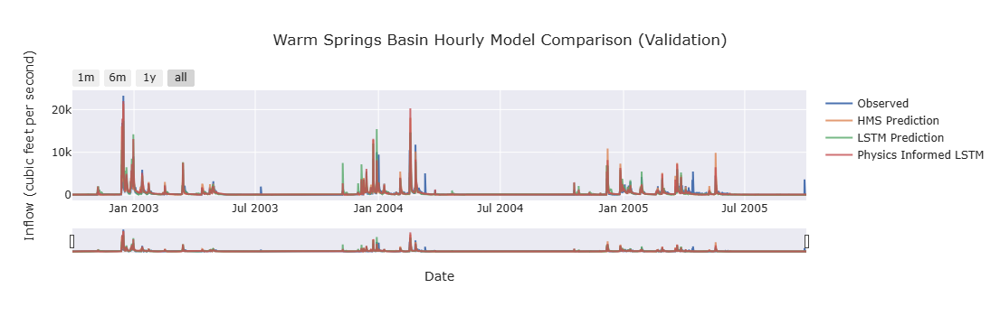

In [19]:
if not skip_best_model_train:
    fancyCombinedPlot(
        lstm_results=no_physics_val_csv,
        lstmPhysics_results=physics_val_csv,
        HMS_results=path_to_physics_data,
        title='Warm Springs Basin Hourly Model Comparison (Validation)',
        fName="warm_springs_hourly_val_metrics.csv",
        timeseries_filename ="warm_springs_hourly_val_combined_ts.csv"
    )
else:
    fancyCombinedPlotFromDf(combined_df, title='Warm Springs Basin Hourly Model Comparison (Validation)', fName="warm_springs_hourly_val_metrics.csv")

In [20]:
if skip_best_model_train:
    val_metrics = pd.read_csv("warm_springs_hourly_val_metrics.csv", index_col=0)
    print(val_metrics)

### Re-run test with best hyperparameters

2025-03-09 16:08:09,019: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_160809\output.log initialized.
2025-03-09 16:08:09,021: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_160809
2025-03-09 16:08:09,023: ### Run configurations for testing_run
2025-03-09 16:08:09,024: experiment_name: testing_run
2025-03-09 16:08:09,025: train_basin_file: warm springs
2025-03-09 16:08:09,026: validation_basin_file: warm springs
2025-03-09 16:08:09,028: test_basin_file: warm springs
2025-03-09 16:08:09,029: train_start_date: 1994-10-01 00:00:00
2025-03-09 16:08:09,030: train_end_date: 2005-09-30 00:00:00
2025-03-09 16:08:09,031: validation_start_date: 2002-10-01 00:00:00
2025-03-09 16:08:09,033: validation_end_date: 2005-09-30 00:00:00
2025-03-09 16:08:09,034: test_start_date: 2005-10-01 00:00:00
2025-03-09 16:08:09,035: test_end_date: 2009-09-29 00:00:00
2025-03-09 16:08:09,036: device: 

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental featur

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.37s/it]
2025-03-09 16:29:02,482: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_160809\validation\model_epoch032\validation_metrics.csv
2025-03-09 16:29:02,489: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_160809\validation\model_epoch032\validation_results.p
2025-03-09 16:29:02,591: Using the model weights from F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_160809\model_epoch032.pt


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental featur

# Evaluation: 100%|██████████| 1/1 [00:09<00:00,  9.93s/it]
2025-03-09 16:29:12,545: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_160809\test\model_epoch032\test_metrics.csv
2025-03-09 16:29:12,558: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_160809\test\model_epoch032\test_results.p
got predictions


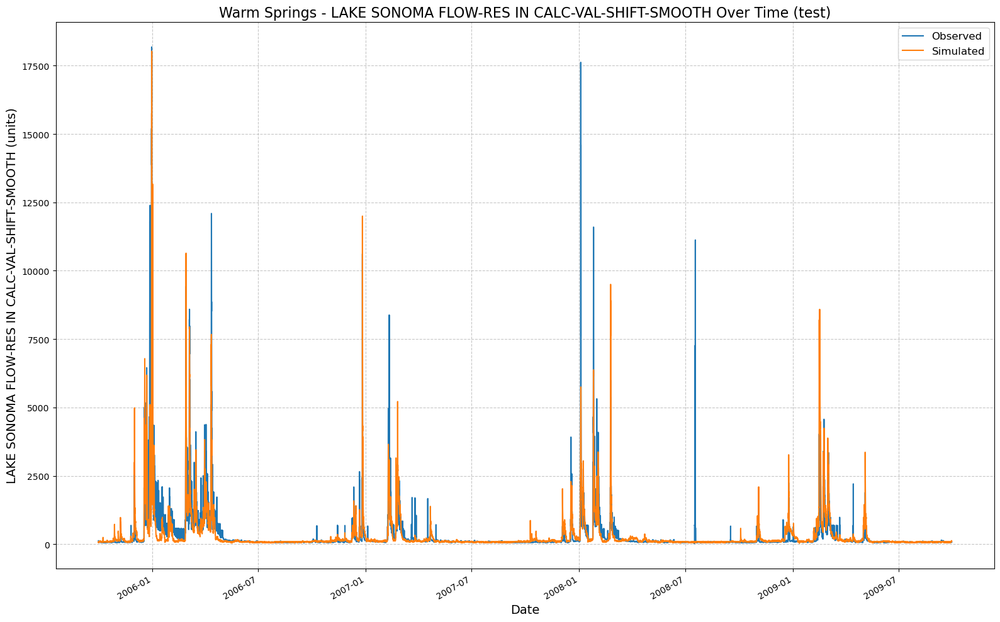

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.



[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_160809\results_output_test.csv


In [22]:
if not skip_best_model_train:
    lstmNoPhysicsExtBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=True,  
        gpu=0
    )
    
    lstmNoPhysicsExtBest.train()
    no_physics_test_csv, no_physics_test_metrics = lstmNoPhysicsExtBest.results('test')
    no_physics_test_metrics

2025-03-09 16:29:13,929: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_162913\output.log initialized.
2025-03-09 16:29:13,931: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_162913
2025-03-09 16:29:13,932: ### Run configurations for testing_run
2025-03-09 16:29:13,934: experiment_name: testing_run
2025-03-09 16:29:13,935: train_basin_file: warm springs
2025-03-09 16:29:13,937: validation_basin_file: warm springs
2025-03-09 16:29:13,938: test_basin_file: warm springs
2025-03-09 16:29:13,940: train_start_date: 1994-10-01 00:00:00
2025-03-09 16:29:13,942: train_end_date: 2005-09-30 00:00:00
2025-03-09 16:29:13,943: validation_start_date: 2002-10-01 00:00:00
2025-03-09 16:29:13,945: validation_end_date: 2005-09-30 00:00:00
2025-03-09 16:29:13,947: test_start_date: 2005-10-01 00:00:00
2025-03-09 16:29:13,948: test_end_date: 2009-09-29 00:00:00
2025-03-09 16:29:13,949: device: 

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental featur

# Validation: 100%|██████████| 1/1 [00:14<00:00, 14.06s/it]
2025-03-09 16:52:33,933: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_162913\validation\model_epoch016\validation_metrics.csv
2025-03-09 16:52:33,941: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_162913\validation\model_epoch016\validation_results.p
2025-03-09 16:52:34,079: Using the model weights from F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_162913\model_epoch016.pt


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental featur

# Evaluation: 100%|██████████| 1/1 [00:17<00:00, 17.86s/it]
2025-03-09 16:52:51,958: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_162913\test\model_epoch016\test_metrics.csv
2025-03-09 16:52:51,969: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_162913\test\model_epoch016\test_results.p
got predictions


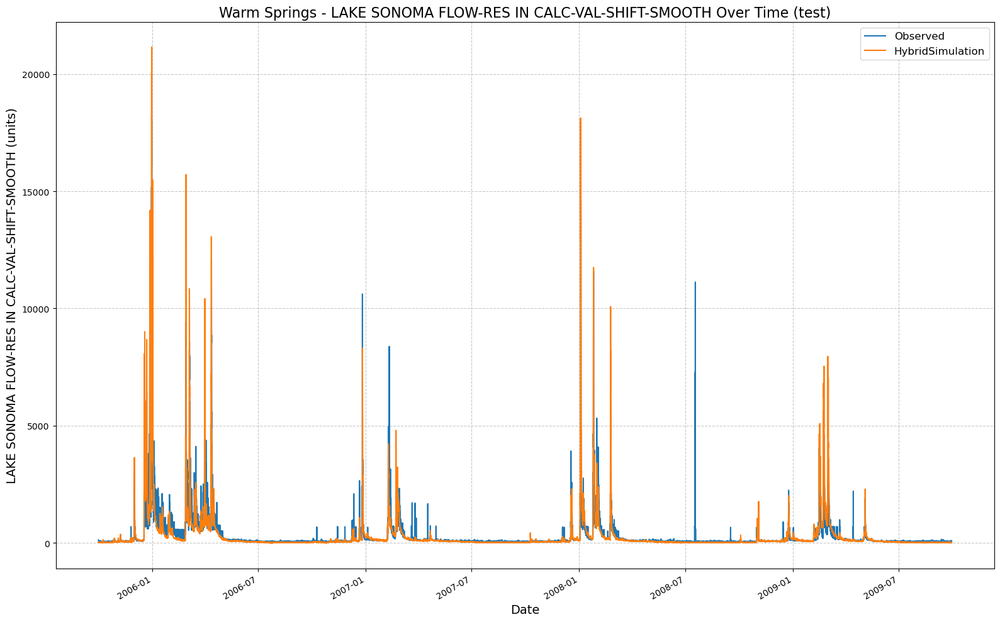

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.



[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_0903_162913\results_output_test.csv


In [23]:
if not skip_best_model_train:
    lstmPhysicsExtBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data,
        hourly=True,
        extend_train_period=True,
        gpu=0
    )
    
    lstmPhysicsExtBest.train()
    physics_test_csv, physics_test_metrics = lstmPhysicsExtBest.results('test')
    physics_test_metrics

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:61: DtypeWarning:

Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_spri

[INFO] Wrote metrics CSV: warm_springs_hourly_test_metrics.csv
[INFO] Saved figure: warm_springs_hourly_test_model_comparison.png


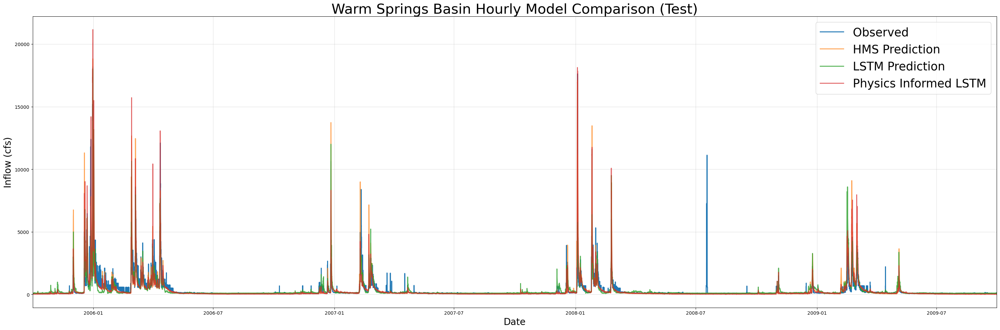

In [24]:
if not skip_best_model_train:
    combinedPlot(
        lstm_results=no_physics_test_csv,
        lstmPhysics_results=physics_test_csv,
        HMS_results=path_to_physics_data,
        title="Warm Springs Basin Hourly Model Comparison (Test)",
        fName="warm_springs_hourly_test_metrics.csv",
        plot_filename="warm_springs_hourly_test_model_comparison.png", 
        timeseries_filename ="warm_springs_hourly_test_combined_ts.csv"
    )
else:
    combined_df = pd.read_csv("warm_springs_hourly_test_combined_ts.csv")
    combinedPlotFromDf(combined_df, title="Warm Springs Basin Hourly Model Comparison (Test)", fName="warm_springs_hourly_test_metrics.csv")

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:129: DtypeWarning:

Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_spr

[INFO] Wrote metrics CSV: warm_springs_hourly_test_metrics.csv


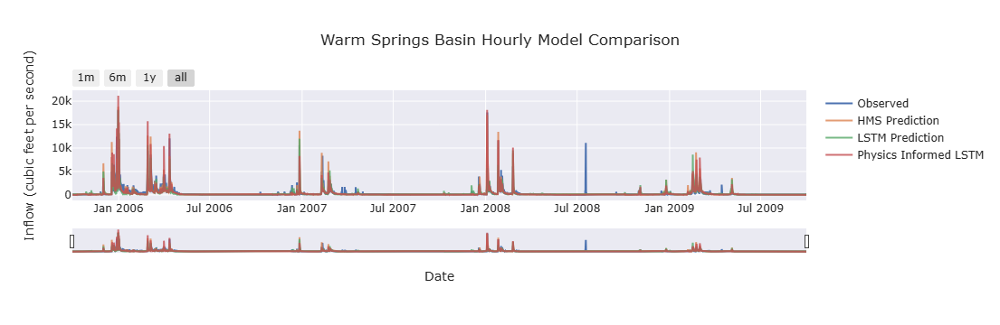

In [25]:
if not skip_best_model_train:
    fancyCombinedPlot(lstm_results=no_physics_test_csv, lstmPhysics_results= physics_test_csv, HMS_results=path_to_physics_data, title='Warm Springs Basin Hourly Model Comparison', fName = "warm_springs_hourly_test_metrics.csv", timeseries_filename ="warm_springs_hourly_test_combined_ts.csv")
else:
    fancyCombinedPlotFromDf(combined_df, title='Warm Springs Basin Hourly Model Comparison', fName = "warm_springs_hourly_test_metrics.csv")

In [26]:
test_metrics = pd.read_csv("warm_springs_hourly_test_metrics.csv", index_col=0)
print(test_metrics)

                       HMS           LSTM  Physics_Informed_LSTM
NSE               0.613711       0.711424               0.699976
MSE          259714.682566  194018.747429          201715.888016
RMSE            509.622098     440.475592             449.127919
KGE               0.760494       0.802072               0.768468
Alpha-NSE         1.183732       0.878147               1.199687
Beta-KGE          1.038161       1.006138               0.955277
Beta-NSE          0.013852       0.002228              -0.016234
Pearson-r         0.851174       0.844148               0.891686
FHV              25.384241      -6.738203              24.074463
FMS              30.904678      -6.533697              97.401567
FLV              79.780767       0.909489           -2064.136699
Peak-Timing            NaN            NaN                    NaN
Peak-MAPE        55.160802      48.883676              45.770160
